In [1]:
from generate_spectra import get_data_spectra
from sbi_posterior import main as sbi_posterior
import numpy as np
from time import time
import torch
from torch.distributions import half_normal, normal, uniform
import matplotlib.pyplot as plt
import matplotlib.cm
from scipy import stats
cmap = matplotlib.cm.get_cmap("tab10")

def bin_spectrum(cls, lmin=2, lmax_intern=200, lmax=383, binwidth=10, big_bin=True):
    """
    Bin a 1d array of power spectra using the standard binning.

    Arguments
    ---------
    cls : array_like
        Cls
    lmin : scalar, optional
        Minimum ell of the first bin.  Default: 2.
    lmax_intern : scalar, optional
        ell of the last bin for a single spectrum. Default: 383
    binwidth : scalar, optional
        Width of each bin.  Default: 10.
    big_bin : bool, optional
        Keep the bin after lmax_intern. Default: True

    Returns
    -------
    clsb : array_like
        Binned power spectra
    """
    ncl = len(cls)
    ns = int(ncl/(lmax+1))
    starts = np.arange(0, ncl, lmax+1)
    ell = np.arange(ncl)
    internal_bins = np.arange(lmin, lmax_intern+1, binwidth)
    n_int = len(internal_bins)
    ibib, stst = np.meshgrid(internal_bins, starts)
    bins = (ibib+stst).flatten()
    bins = np.append(bins, [ncl])
    clsb = stats.binned_statistic(ell, cls, "mean", bins=bins).statistic
    if not big_bin:
        clsb = np.delete(clsb, np.s_[n_int-1::n_int])
    return clsb

/mn/stornext/u3/aeadler/anaconda2/envs/sbi/lib/python3.7/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/mn/stornext/u3/aeadler/anaconda2/envs/python37/lib/python3.7/site-packages/pkg_resources/__init__.py:126: PkgResourcesDeprecationWarning: 1.11.0-3-g029c is an invalid version and will not be supported in a future release
  PkgResourcesDeprecationWarning,


In [2]:
freqs=np.array([27., 39., 93., 145., 225., 280.])
nside=128
nsplits = 4
nCl = (len(freqs)**2)*(2*2)*(3*nside)*nsplits
nsims = 10000
ntrain = 9900
ntest = nsims - ntrain
binwidth = 10
nspec = (len(freqs)**2)*(2*2)*nsplits #Spectra in a row
nbins = len(np.arange(2, 201, binwidth)) *nspec #Bins per spectrum

data_tensor = np.load("data_tensor_foregrounds_1e4p2.npy")

log_r_vector = np.log(np.load("r_vector2e4.npy")[:,0])

Ad_vector = np.load("Ad_vector2e4.npy")
Bd_vector = np.load("betad_vector2e4.npy")
alphad_vector = np.load("alphad_vector2e4.npy")

As_vector = np.load("As_vector2e4.npy")
Bs_vector = np.load("betas_vector2e4.npy")
alphas_vector = np.load("alphas_vector2e4.npy")

In [3]:
parameter_tensor = np.stack((log_r_vector, 
                                  Ad_vector, 
                                  Bd_vector, 
                                  alphad_vector, 
                                  As_vector, 
                                  Bs_vector, 
                                  alphas_vector))

In [4]:
#Binning the data, going to Cls
ell = np.arange(3*nside)
ell_line = np.tile(ell, nspec)
dfac = ell_line*(ell_line+1)/(2*np.pi)
dfac[::3*nside] = 1. #Otherwise we have issues with ell=0 
idfac = 1.0/dfac
data_tensor = data_tensor*np.broadcast_to(idfac, (nsims, nCl))
binned_data_tensor = np.empty((nsims, nbins-nspec))
t1 = time()
for i in range(nsims):
    binned_data_tensor[i] = bin_spectrum(data_tensor[i], big_bin=False)
print(f"Binned {nsims} samples (binwidth {binwidth}) in {time()-t1:.3f}s")

Binned 10000 samples (binwidth 10) in 99.304s


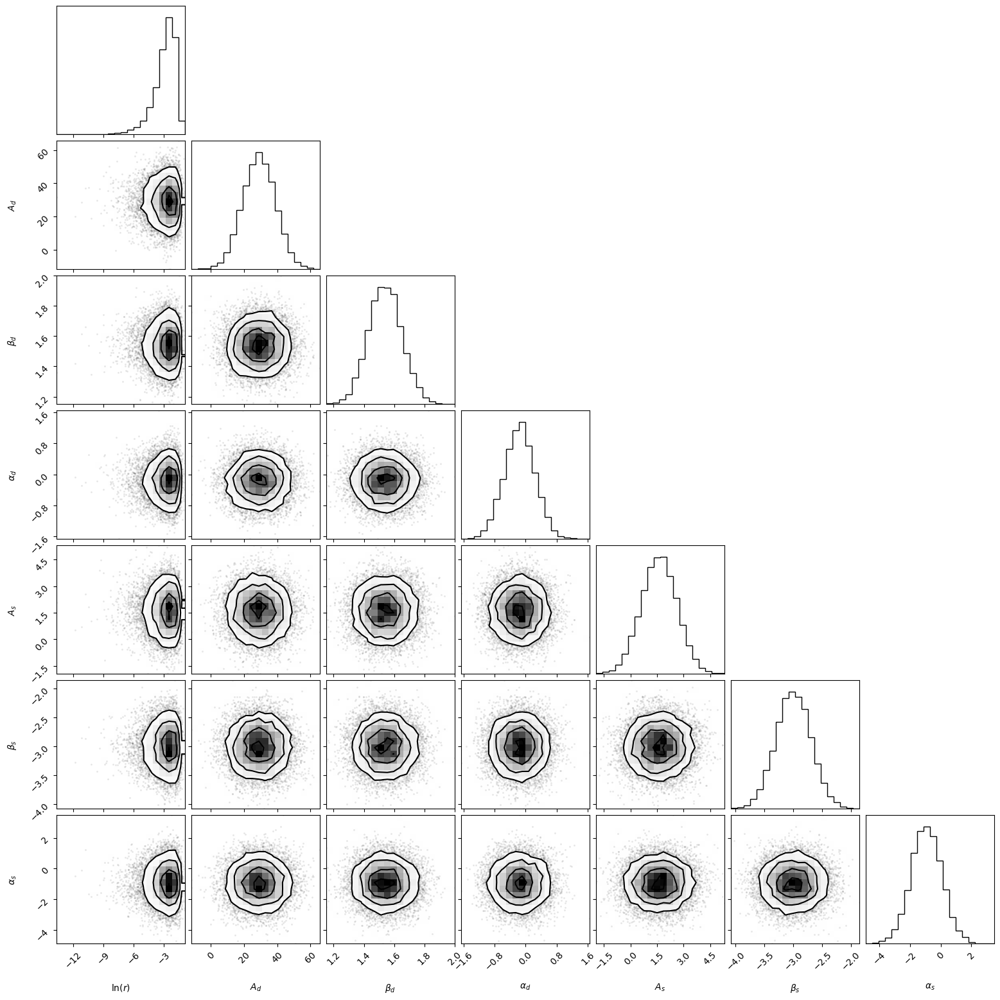

In [5]:
#Plotting the parameters
import corner
params_tensor = parameter_tensor[:,10000:].T
figure = corner.corner(params_tensor, labels=[r"$\ln(r)$", r"$A_d$", r"$\beta_d$",r"$\alpha_d$", 
                                              r"$A_s$", r"$\beta_s$",r"$\alpha_s$"], figsize=(6,6), dpi=100)
plt.show()

In [6]:
#Train: we made sims for the second half of the parameters

t1 = time()
posterior_basic = sbi_posterior(None, params_tensor[:ntrain], binned_data_tensor[:ntrain], density_estimator="maf")
print(f" Trained in {time()-t1:.2f}s with density estimator maf and learning rate 0.0005")

 Neural network successfully converged after 35 epochs.
        -------------------------
        ||||| ROUND 1 STATS |||||:
        -------------------------
        Epochs trained: 35
        Best validation performance: 2.8485
        -------------------------
        
 Trained in 461.25s with density estimator maf and learning rate 0.0005


Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:27<00:00, 370.11it/s]


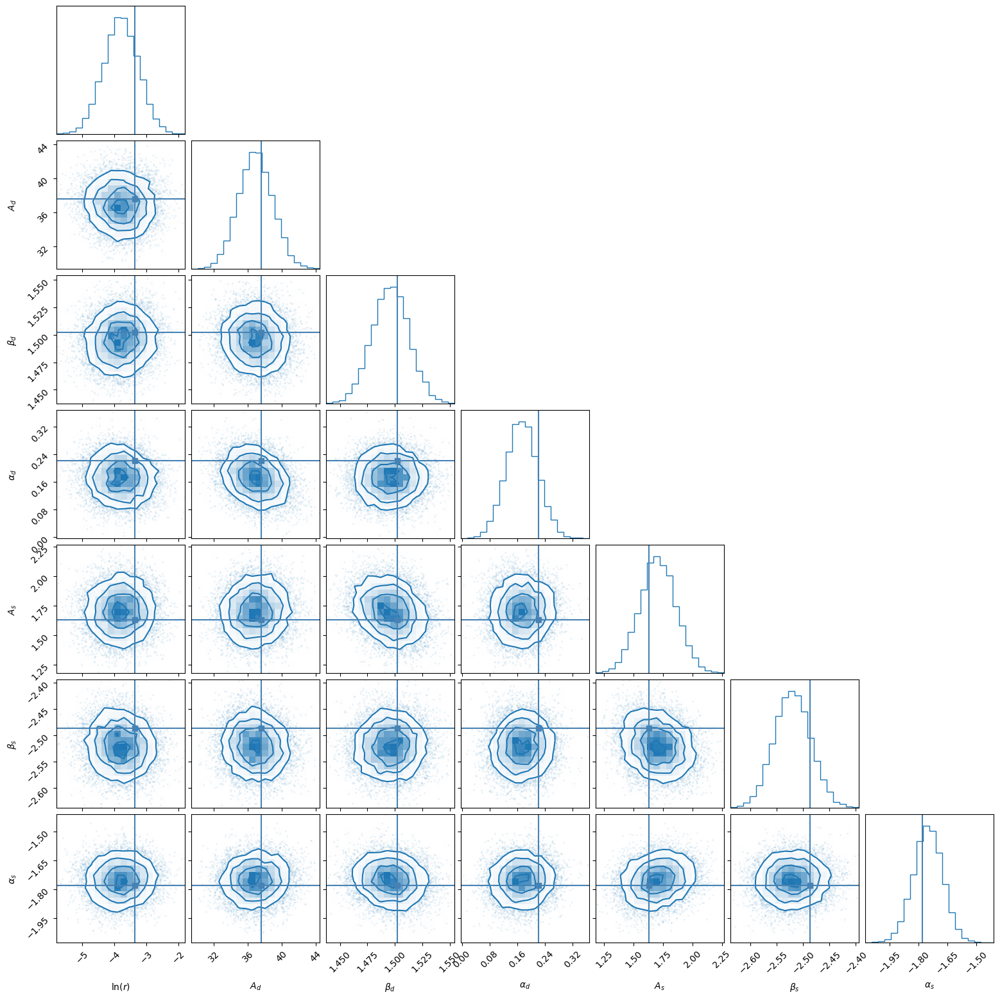

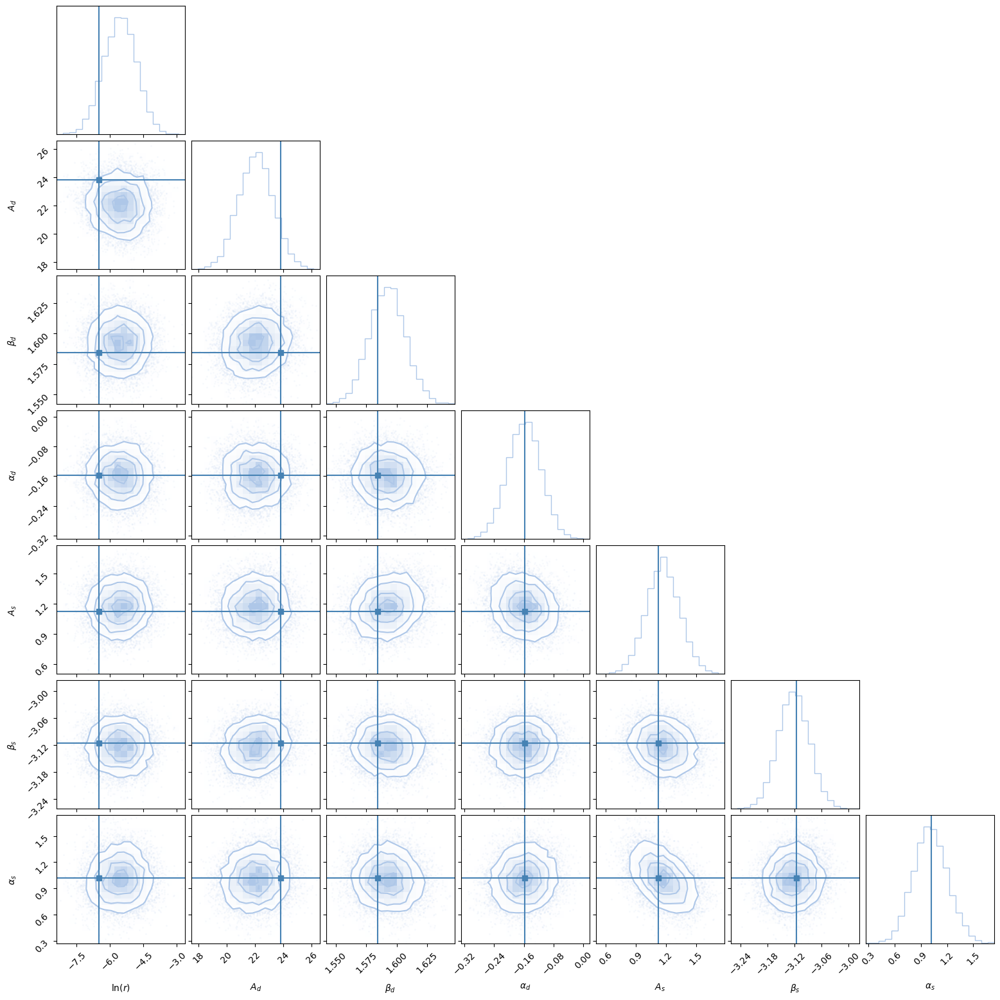

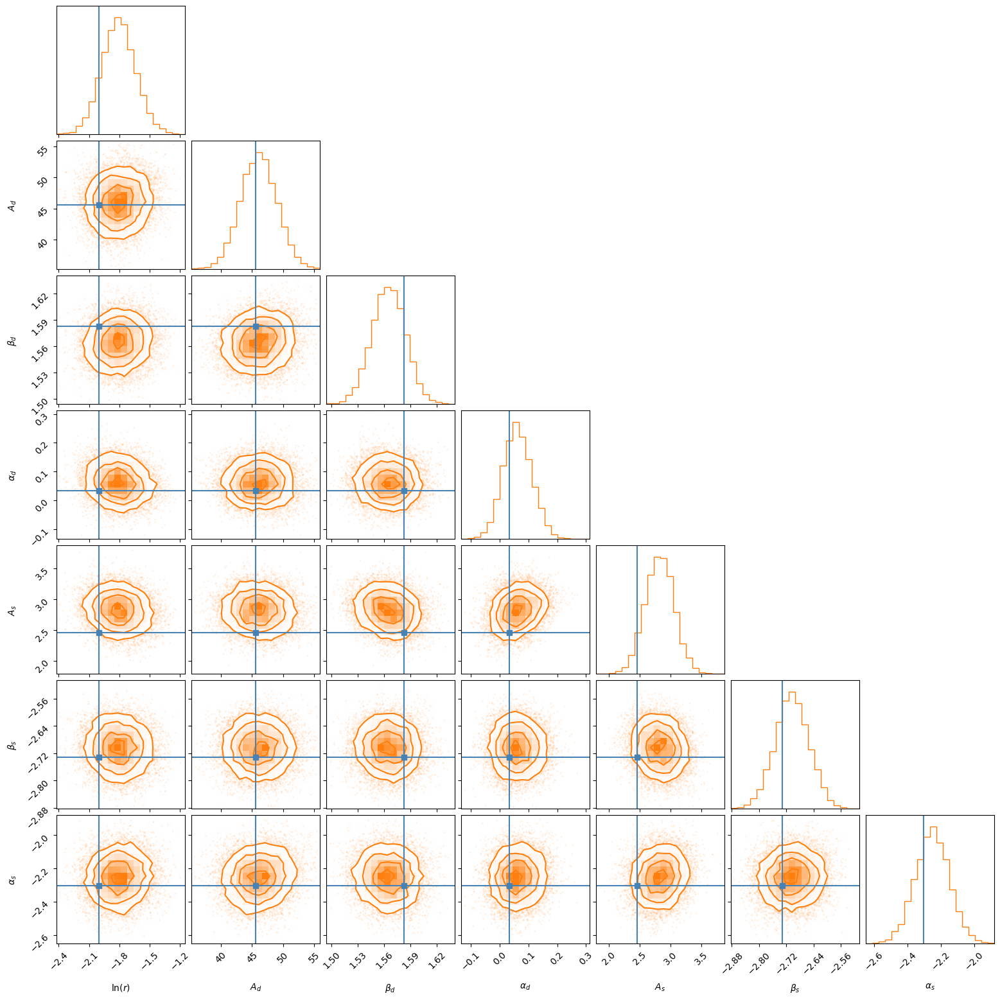

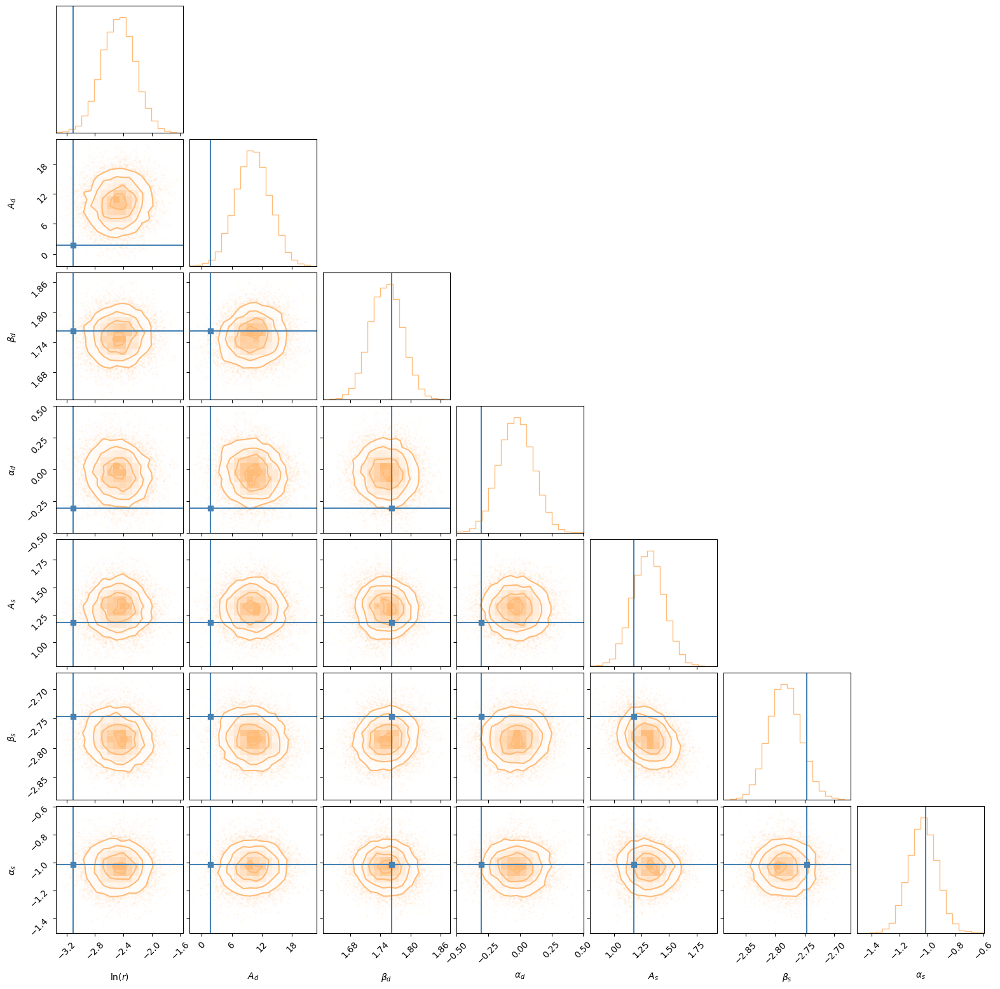

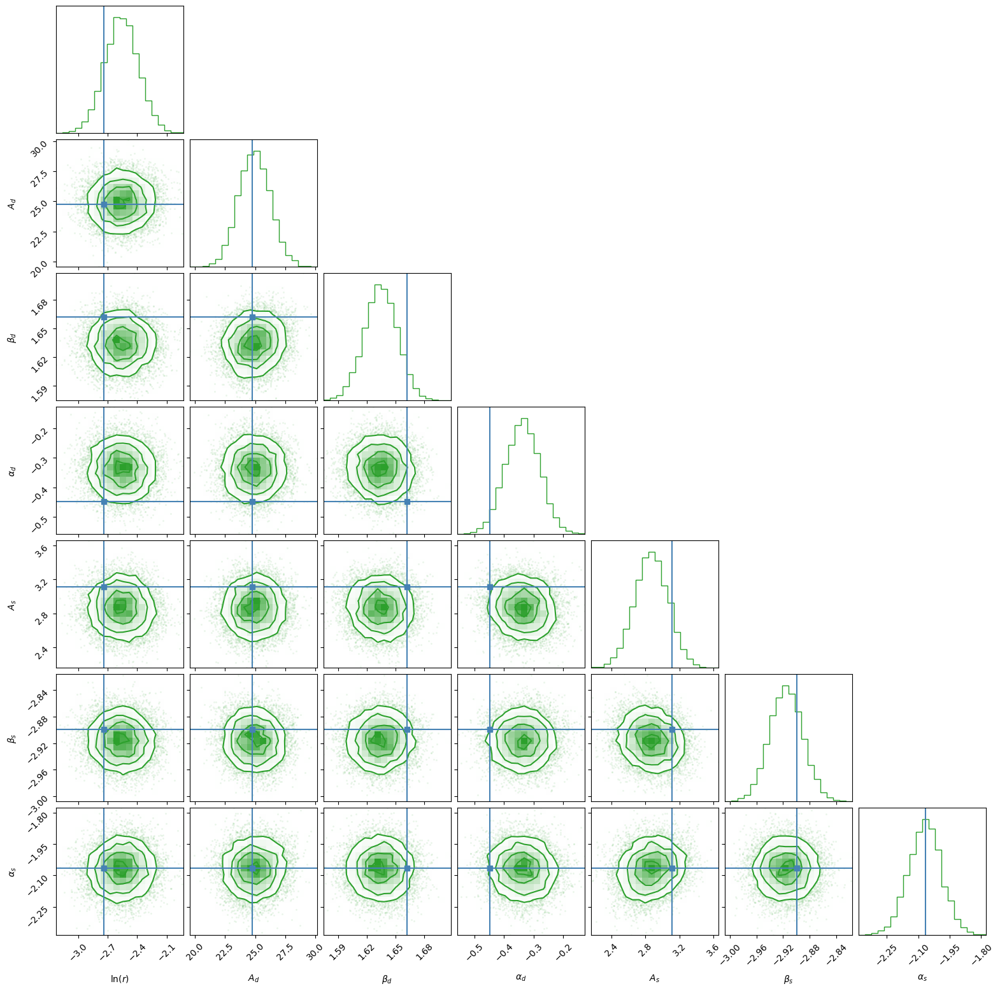

...

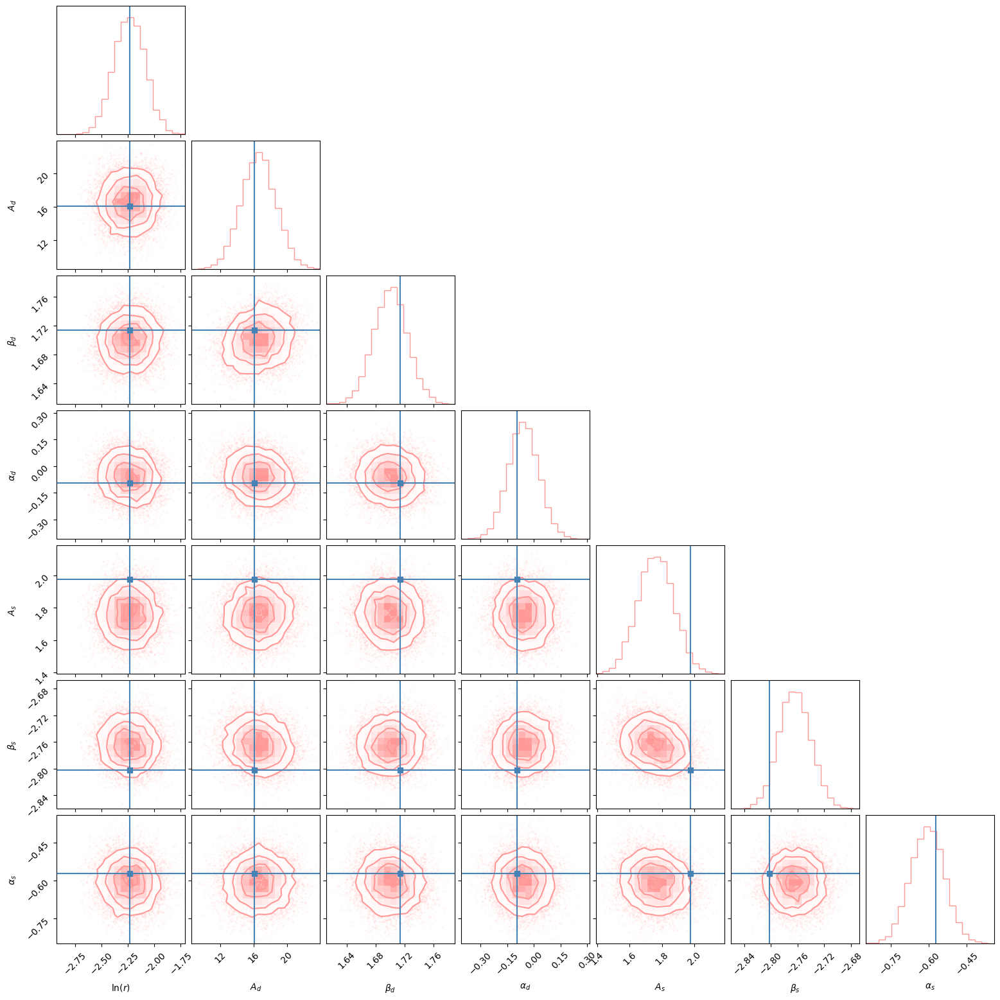

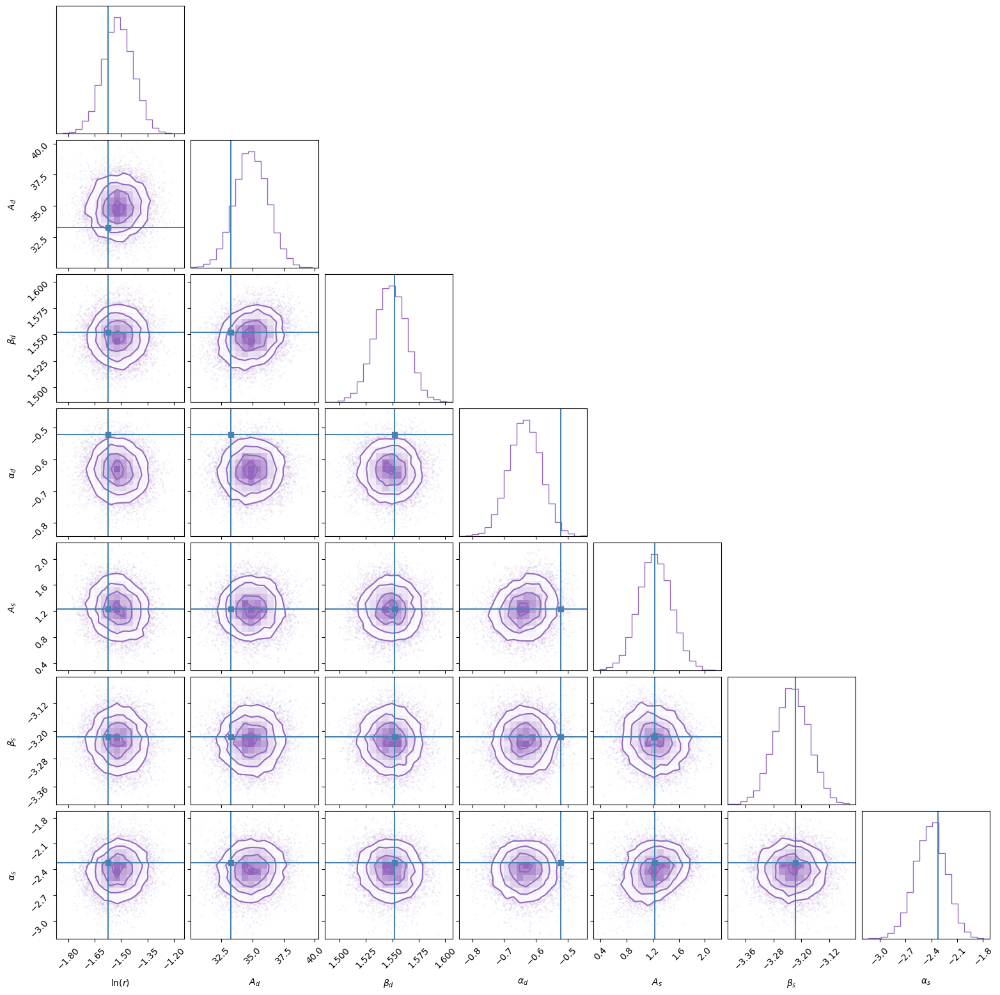

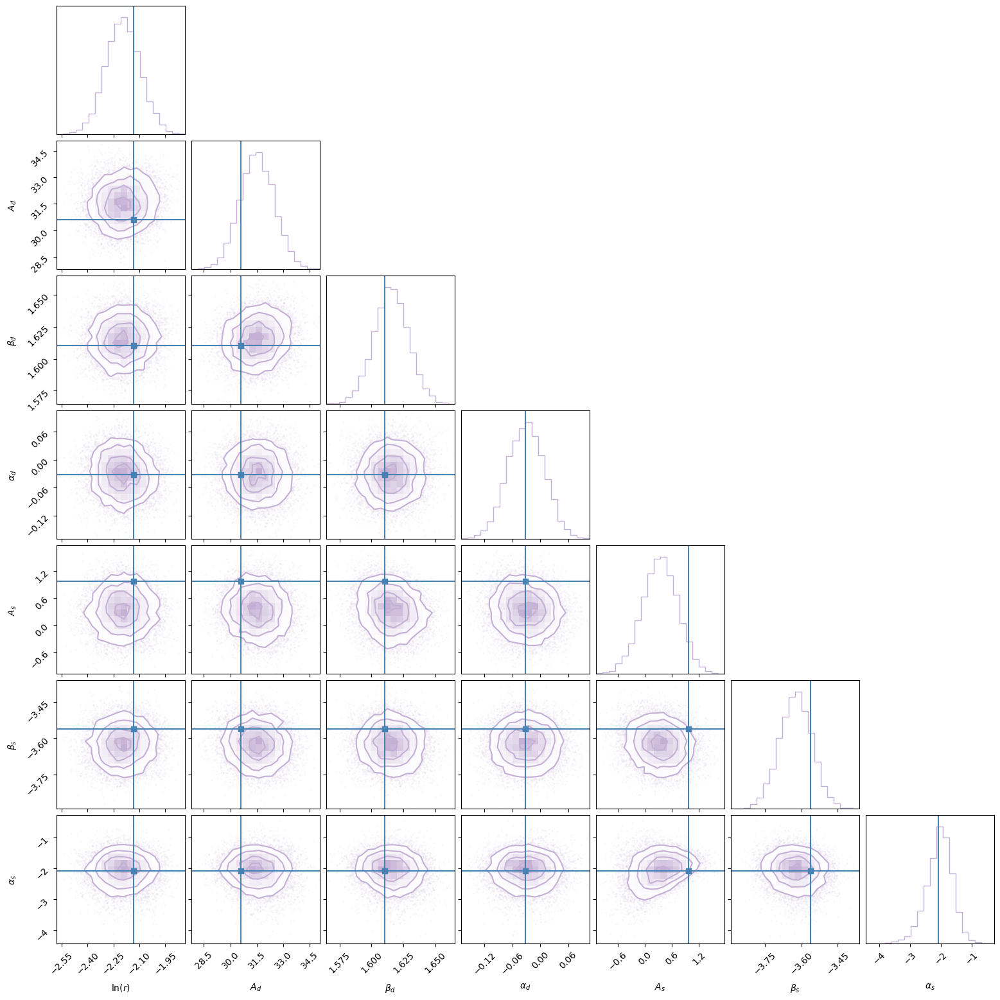

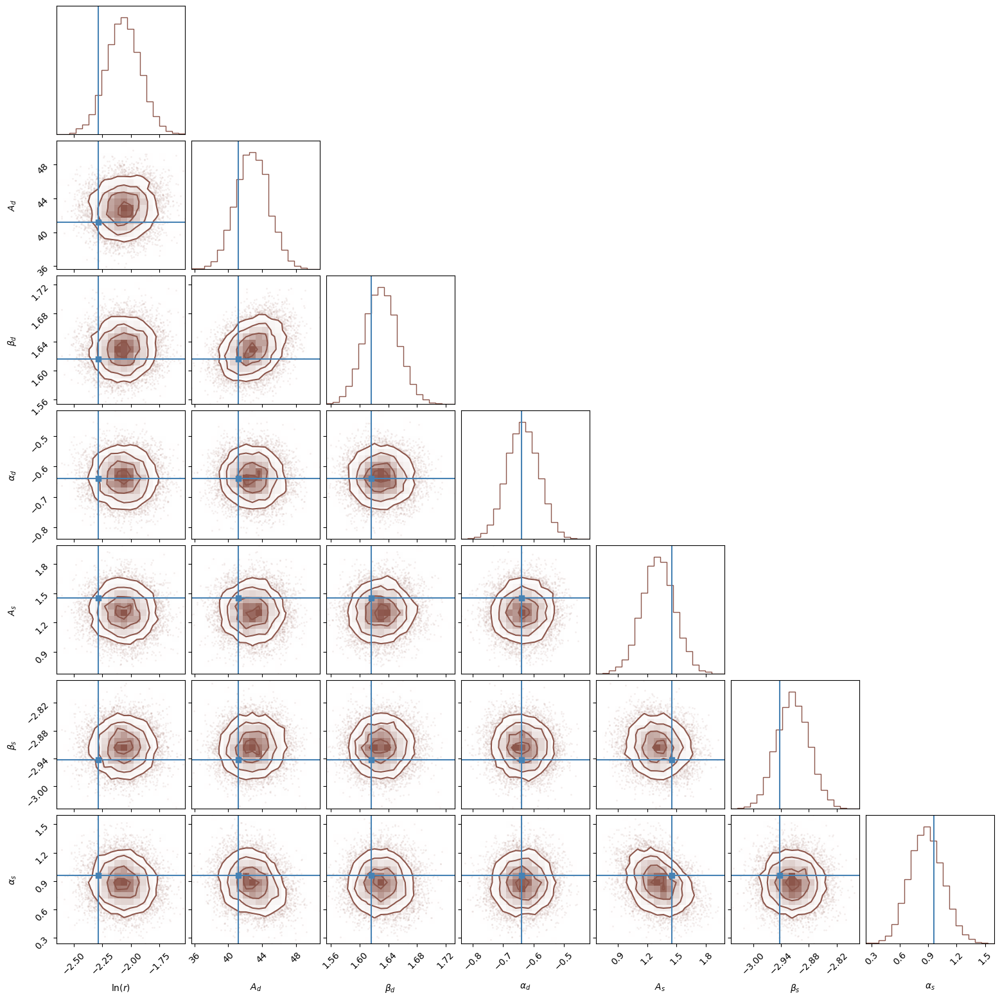

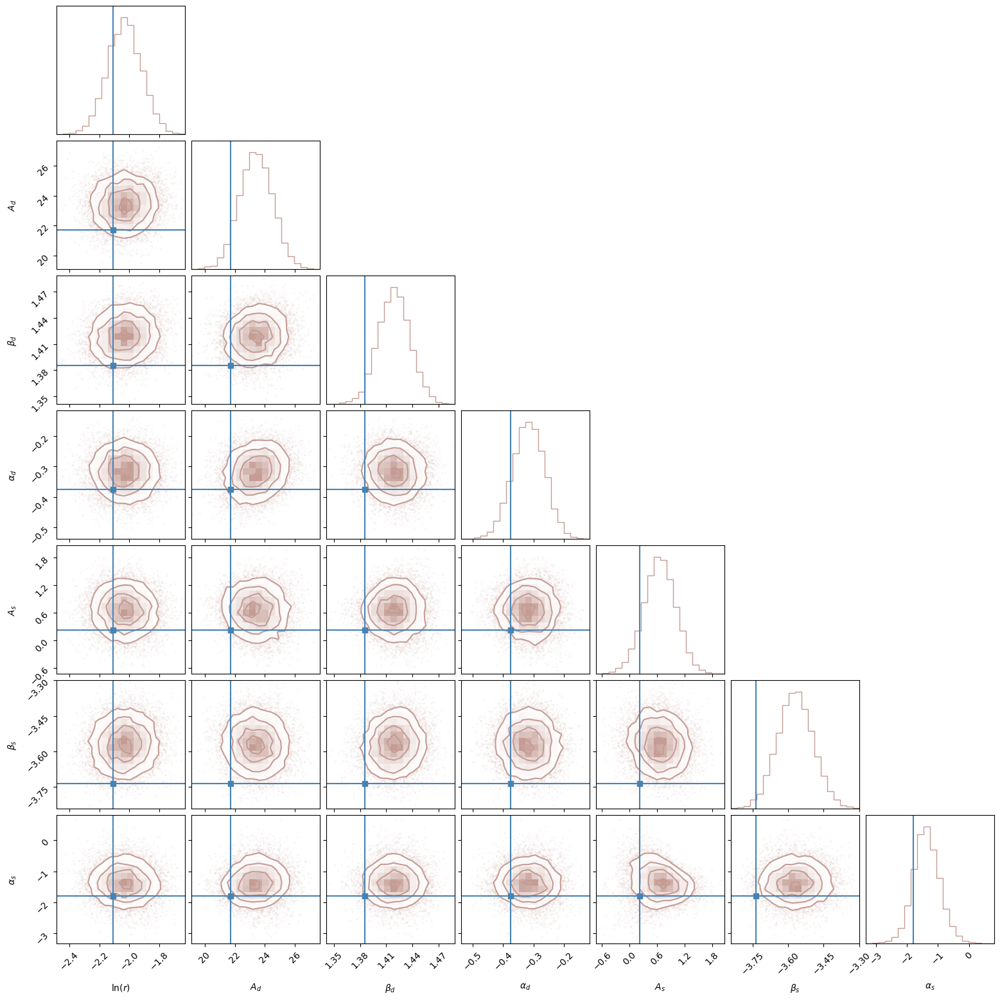

In [8]:
cmap2 = matplotlib.cm.get_cmap("tab20")
for i in range(12):
    pos_sam = posterior_basic.sample((10000,), x=binned_data_tensor[ntrain+i])
    corner.corner(np.array(pos_sam), labels=[r"$\ln(r)$", r"$A_d$", r"$\beta_d$",r"$\alpha_d$", 
                                              r"$A_s$", r"$\beta_s$",r"$\alpha_s$"], 
              figsize=(6,6), dpi=100, color=cmap2(i/20.), truths=np.array(params_tensor[ntrain+i]))

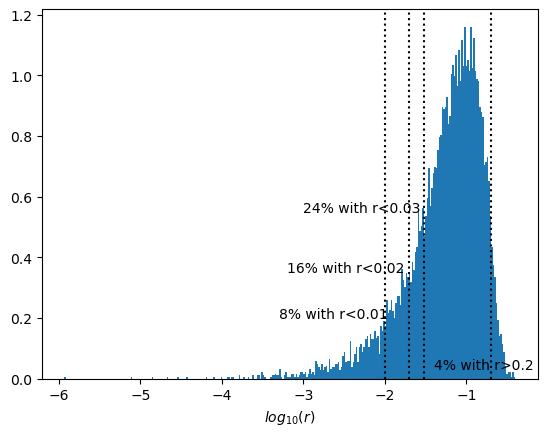

In [66]:
plt.hist(np.log10(np.exp(params_tensor[:,0])), bins=300, density=True)
plt.xlabel(r"$log_{10}(r)$")
plt.text(-3.3, 0.2, "8% with r<0.01")
plt.text(-3.2, 0.35, "16% with r<0.02")
plt.text(-3., 0.55, "24% with r<0.03")
plt.text(-1.4, 0.03, "4% with r>0.2")
plt.axvline(np.log10(0.01), ls=":", c="k")
plt.axvline(np.log10(0.02), ls=":", c="k")
plt.axvline(np.log10(0.03), ls=":", c="k")
plt.axvline(np.log10(0.2), ls=":", c="k")
plt.show()

In [68]:
test_posteriors = np.empty((ntest, 10000, 7))
for i in range(ntest):
    test_posteriors[i] = posterior.sample((10000,), x=binned_data_tensor[ntrain+i])

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 370.71it/s]


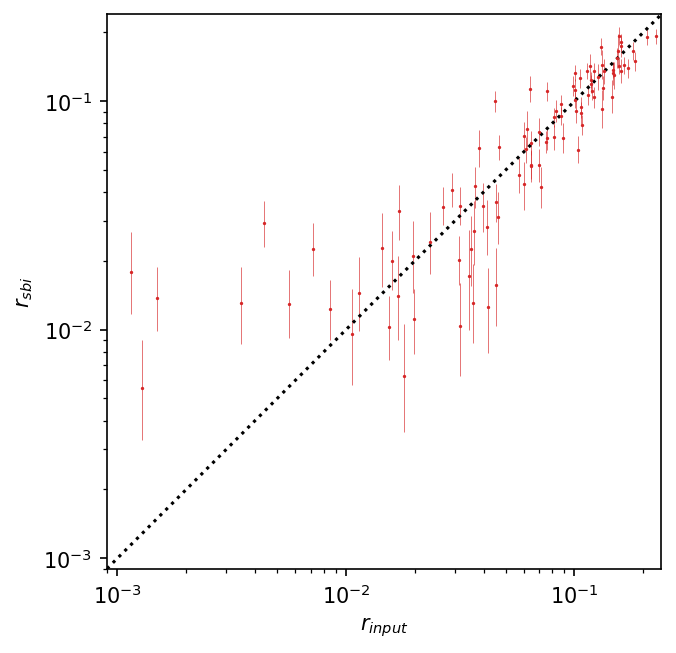

In [94]:
stats_test = np.percentile(test_posteriors, [31.7, 50, 68.3], axis=1)
ym_r = np.exp(stats_test[1,:,0])-np.exp(stats_test[0,:,0])
yp_r =  np.exp(stats_test[2,:,0])-np.exp(stats_test[1,:,0])

fig1, ax1 = plt.subplots(dpi=150)
ax1.errorbar(np.exp(params_tensor[ntrain:,0]), np.exp(stats_test[1,:,0]), yerr=[ym_r, yp_r], 
             ls="", marker="o", color="tab:red", linewidth=0.3, markersize=0.6)
ax1.plot([8e-4, 0.25], [8e-4, 0.25], "k:")
ax1.set_xlabel(r"$r_{input}$")
ax1.set_xscale("log")
ax1.set_xlim(9e-4, 0.24)
ax1.set_ylim(9e-4, 0.24)
ax1.set_ylabel(r"$r_{sbi}$")
ax1.set_yscale("log")
ax1.set_aspect('equal')

In [77]:
t1 = time()
posterior_eve = sbi_posterior(None, params_tensor[:ntrain], binned_data_tensor[:ntrain], 
                              density_estimator="maf", learning_rate=0.001)
print(f" Trained in {time()-t1:.2f}s with learning rate 0.001")

 Neural network successfully converged after 70 epochs.
        -------------------------
        ||||| ROUND 1 STATS |||||:
        -------------------------
        Epochs trained: 70
        Best validation performance: 3.3221
        -------------------------
        
 Trained in 896.23s with learning rate 0.001


Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 370.72it/s]


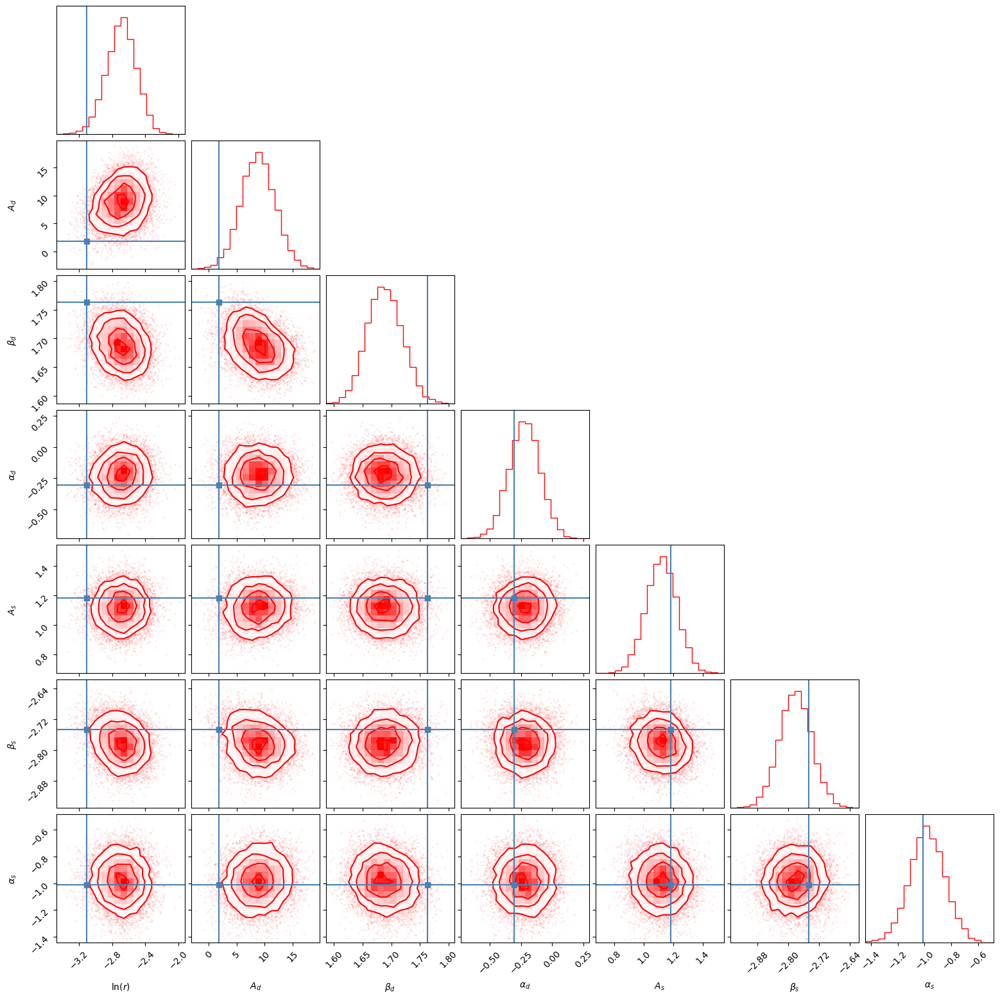

In [79]:
posterior_samps = posterior_eve.sample((10000,), x=binned_data_tensor[ntrain+3])
figure = corner.corner(np.array(posterior_samps), labels=[r"$\ln(r)$", r"$A_d$", r"$\beta_d$",r"$\alpha_d$", 
                                              r"$A_s$", r"$\beta_s$",r"$\alpha_s$"], 
              figsize=(6,6), dpi=100, color="red", truths=np.array(params_tensor[ntrain+3]))
plt.show()

In [95]:
t1 = time()
posterior_lilith = sbi_posterior(None, params_tensor[:ntrain], binned_data_tensor[:ntrain], 
                              density_estimator="maf", learning_rate=0.00025)
print(f" Trained in {time()-t1:.2f}s with learning rate 0.00025")

 Neural network successfully converged after 29 epochs.
        -------------------------
        ||||| ROUND 1 STATS |||||:
        -------------------------
        Epochs trained: 29
        Best validation performance: 2.4910
        -------------------------
        
 Trained in 369.98s with learning rate 0.00025


Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.11it/s]


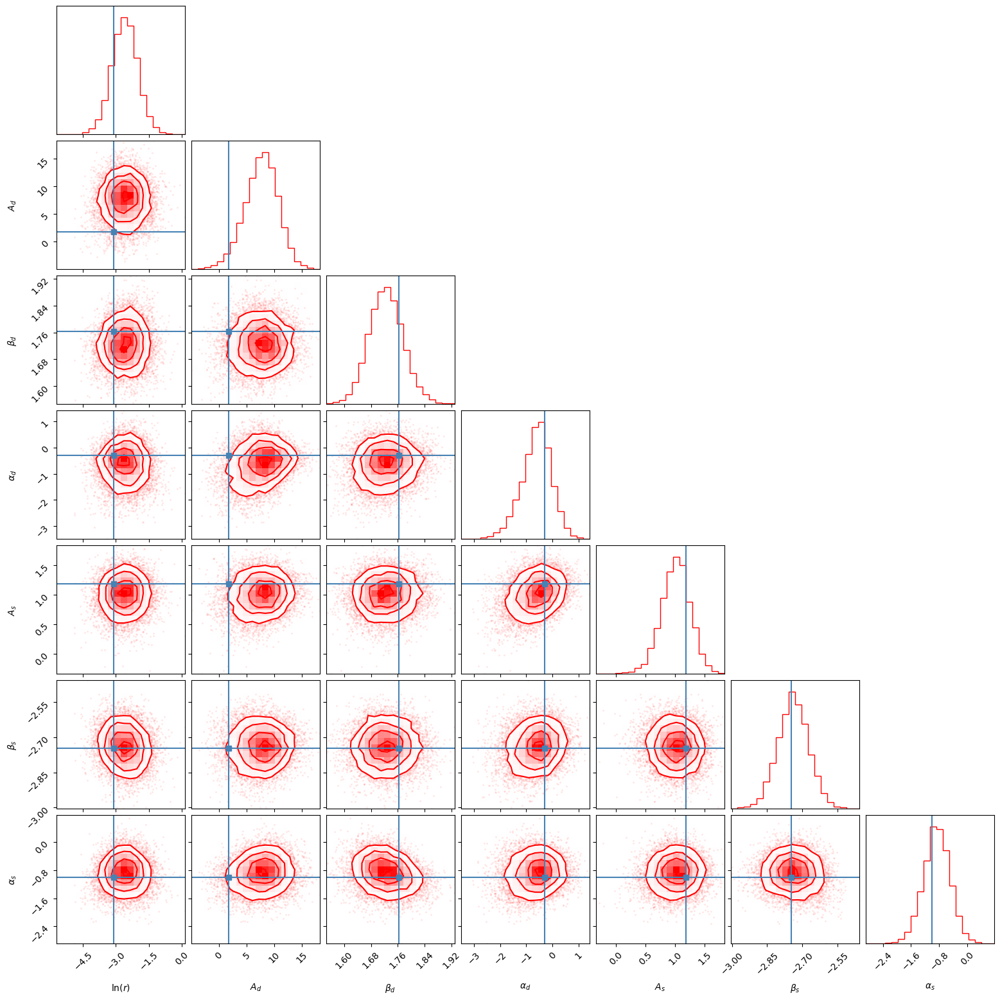

In [96]:
posterior_samps = posterior_lilith.sample((10000,), x=binned_data_tensor[ntrain+3])
figure = corner.corner(np.array(posterior_samps), labels=[r"$\ln(r)$", r"$A_d$", r"$\beta_d$",r"$\alpha_d$", 
                                                          r"$A_s$", r"$\beta_s$",r"$\alpha_s$"], 
              figsize=(6,6), dpi=100, color="red", truths=np.array(params_tensor[ntrain+3]))
plt.show()

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.02it/s]


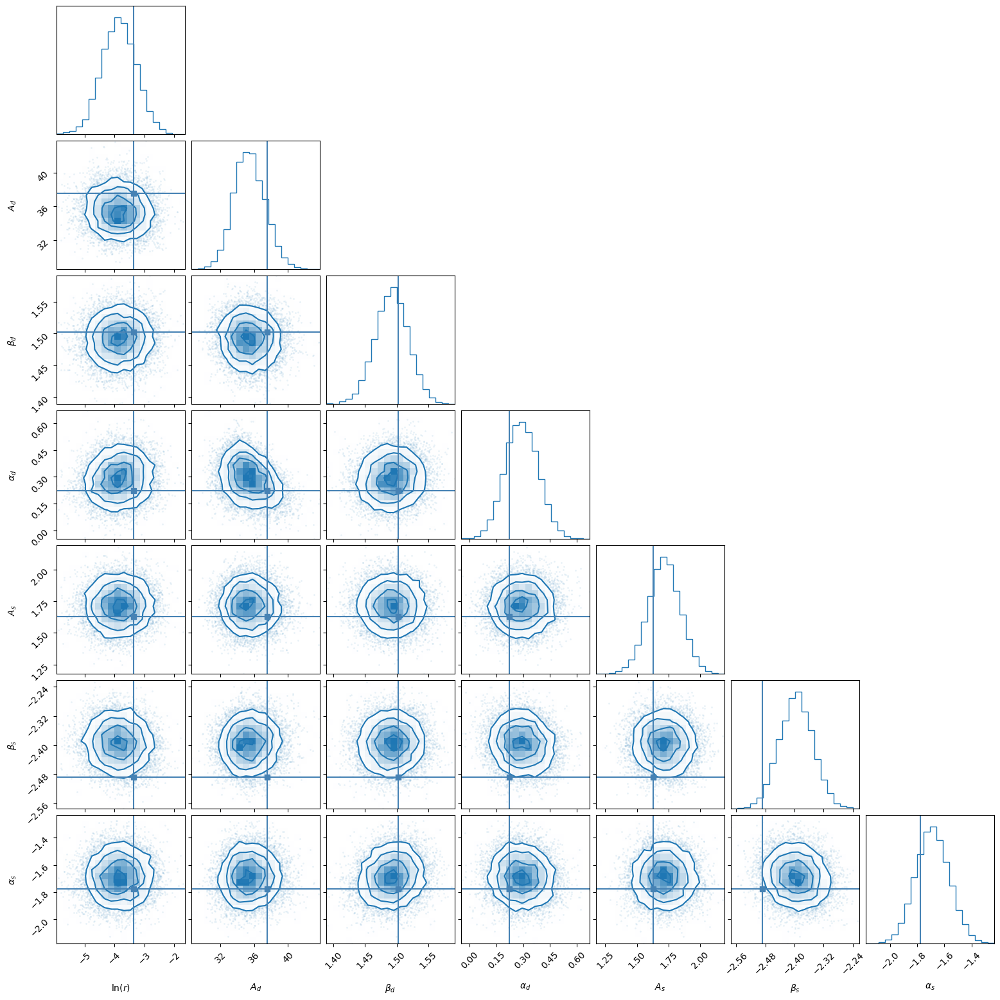

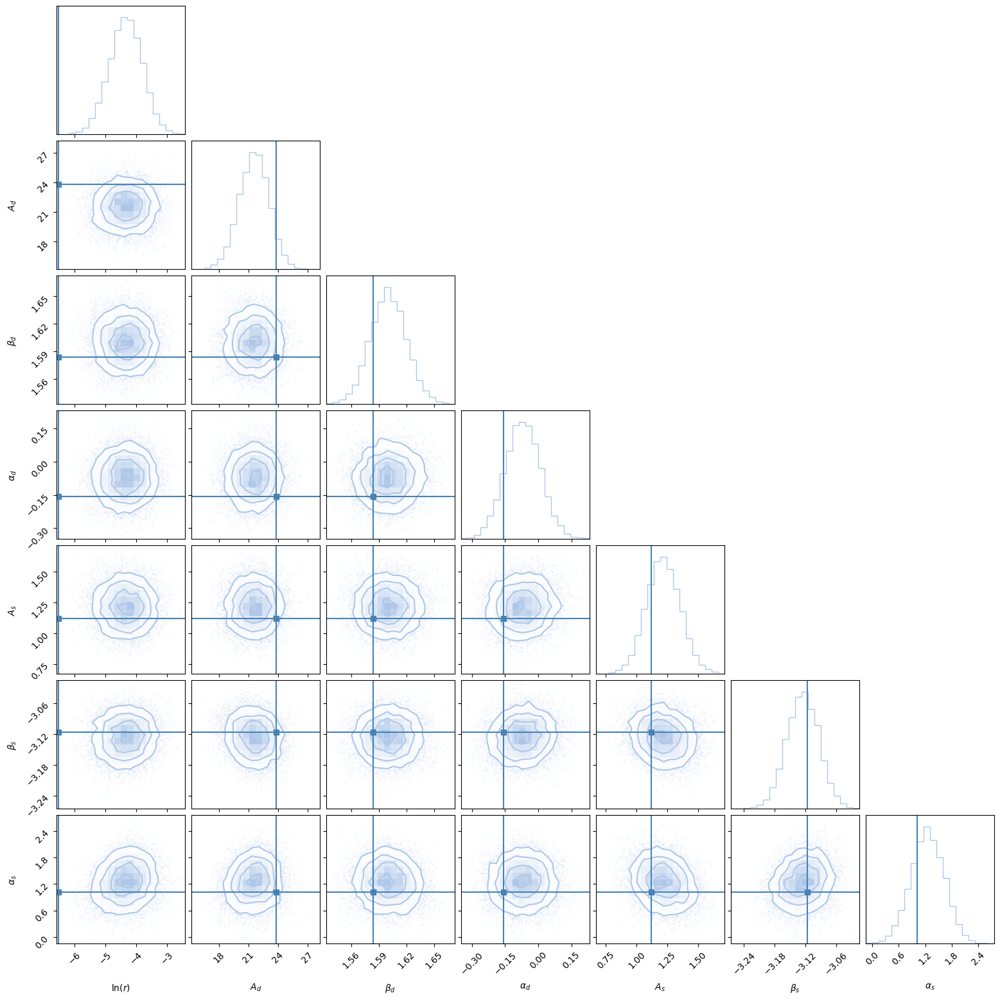

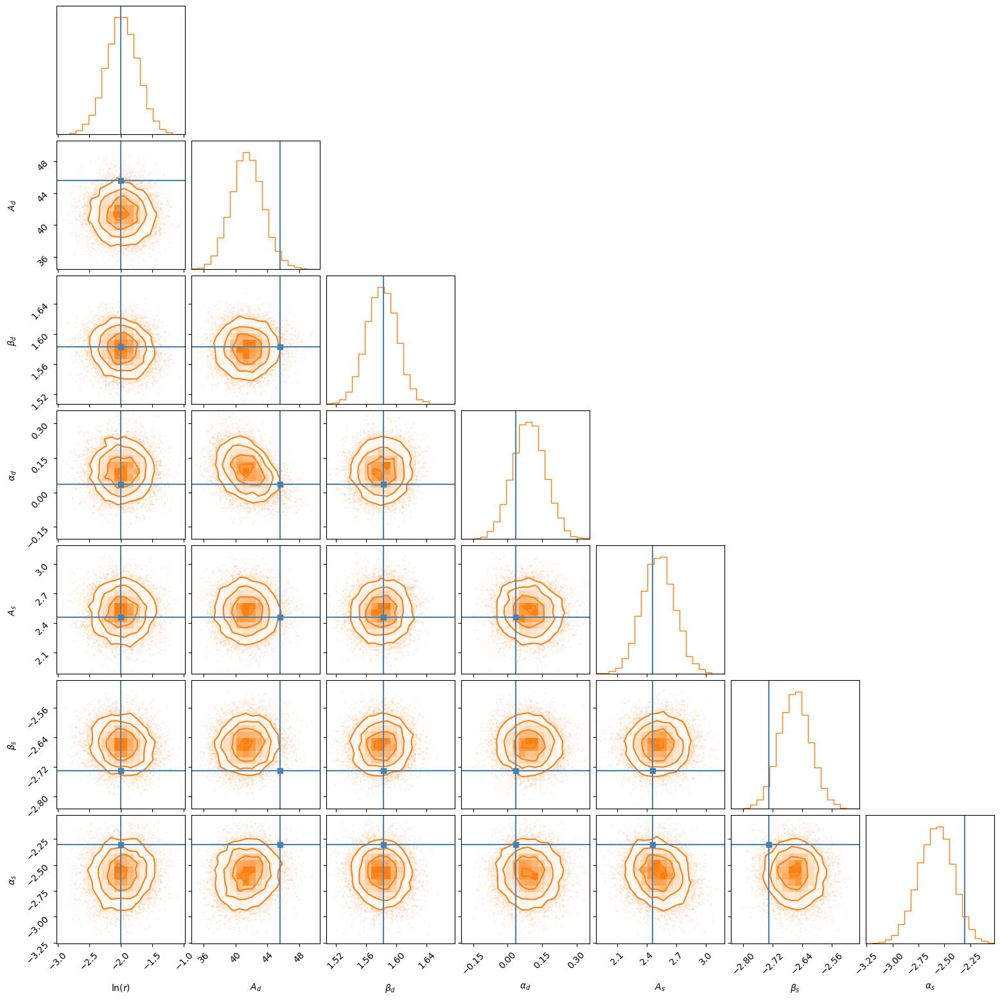

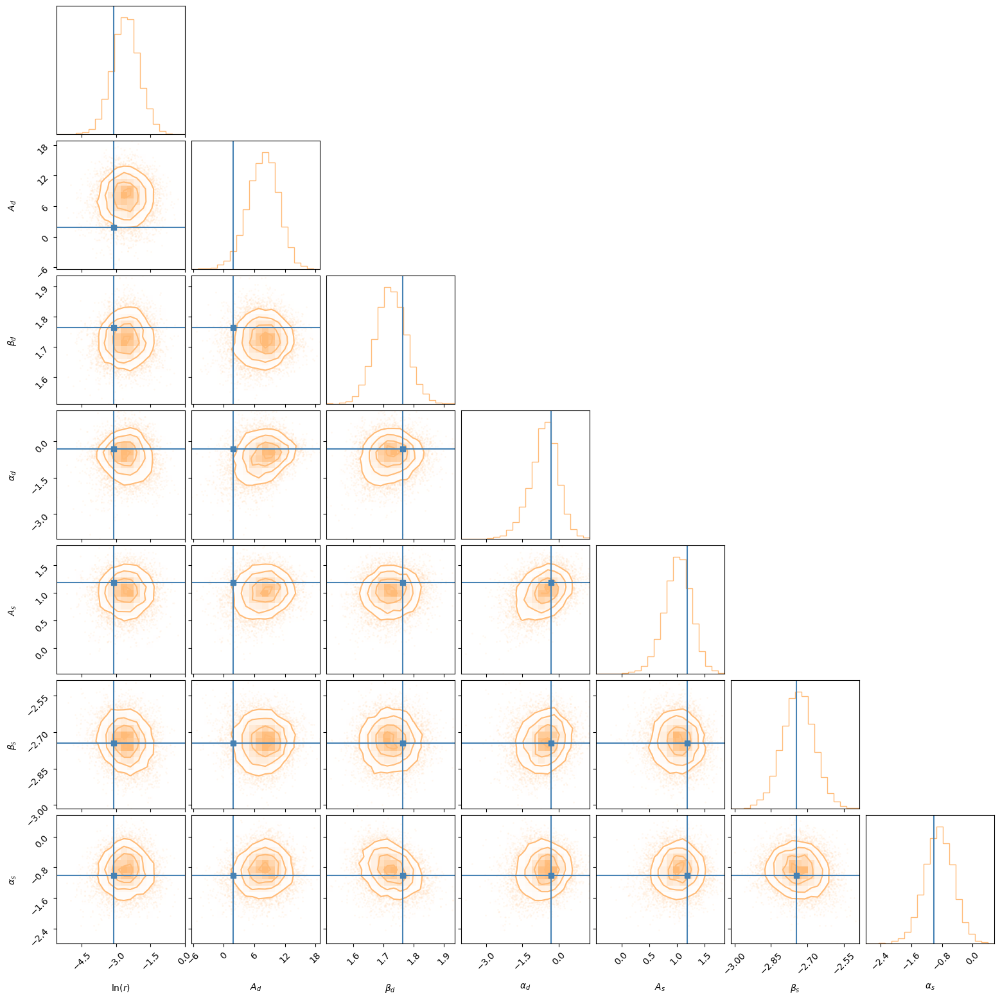

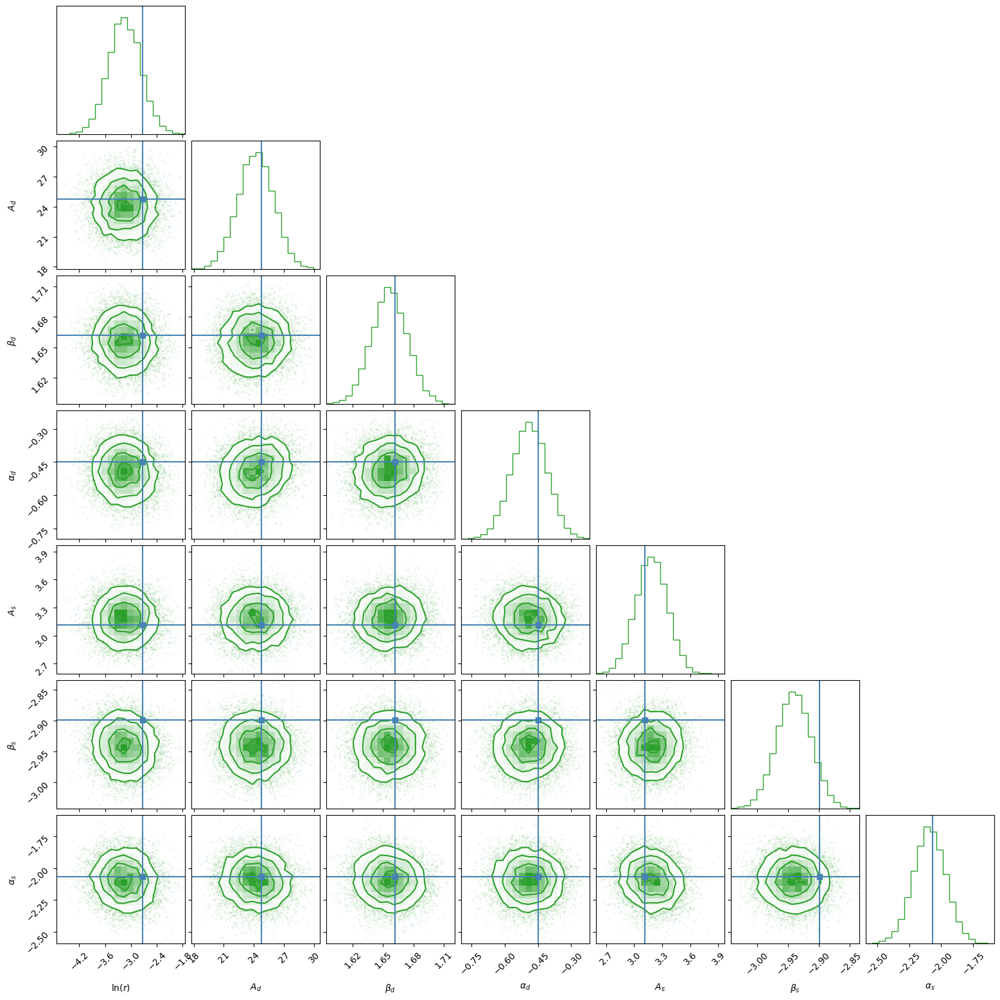

...

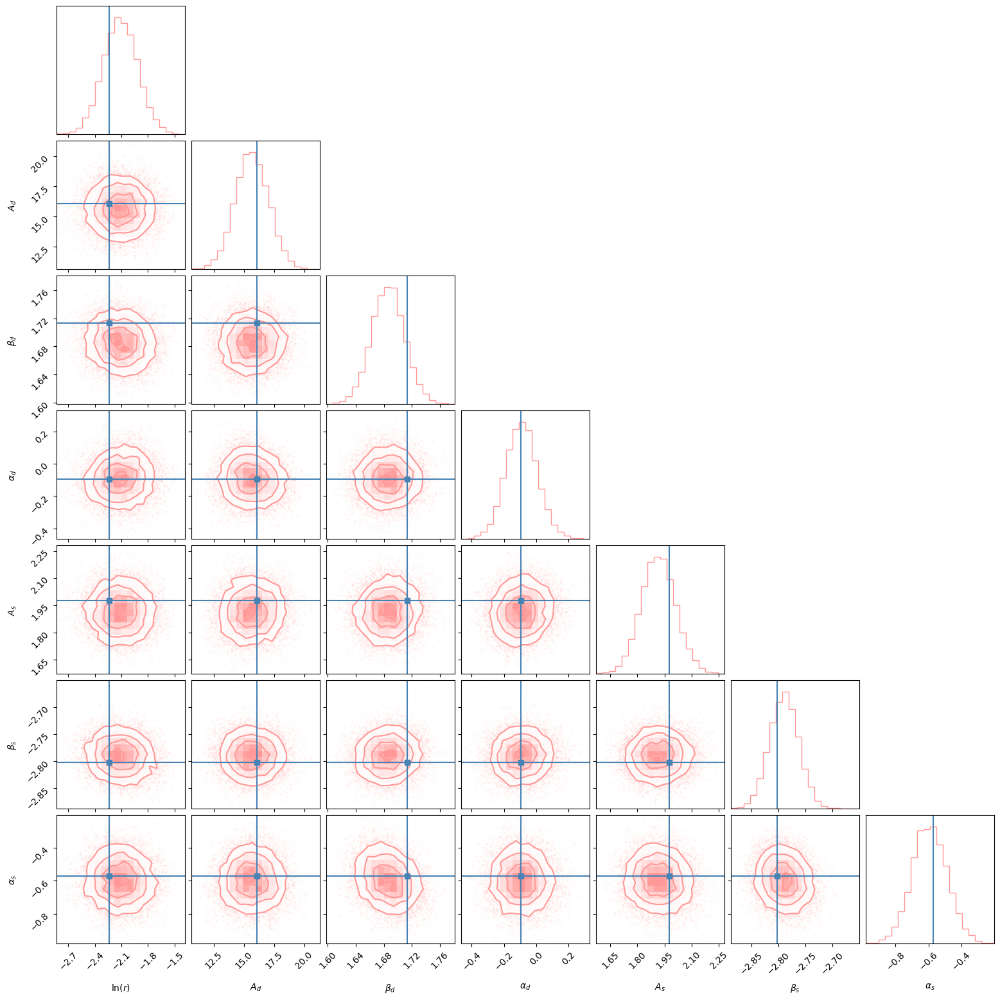

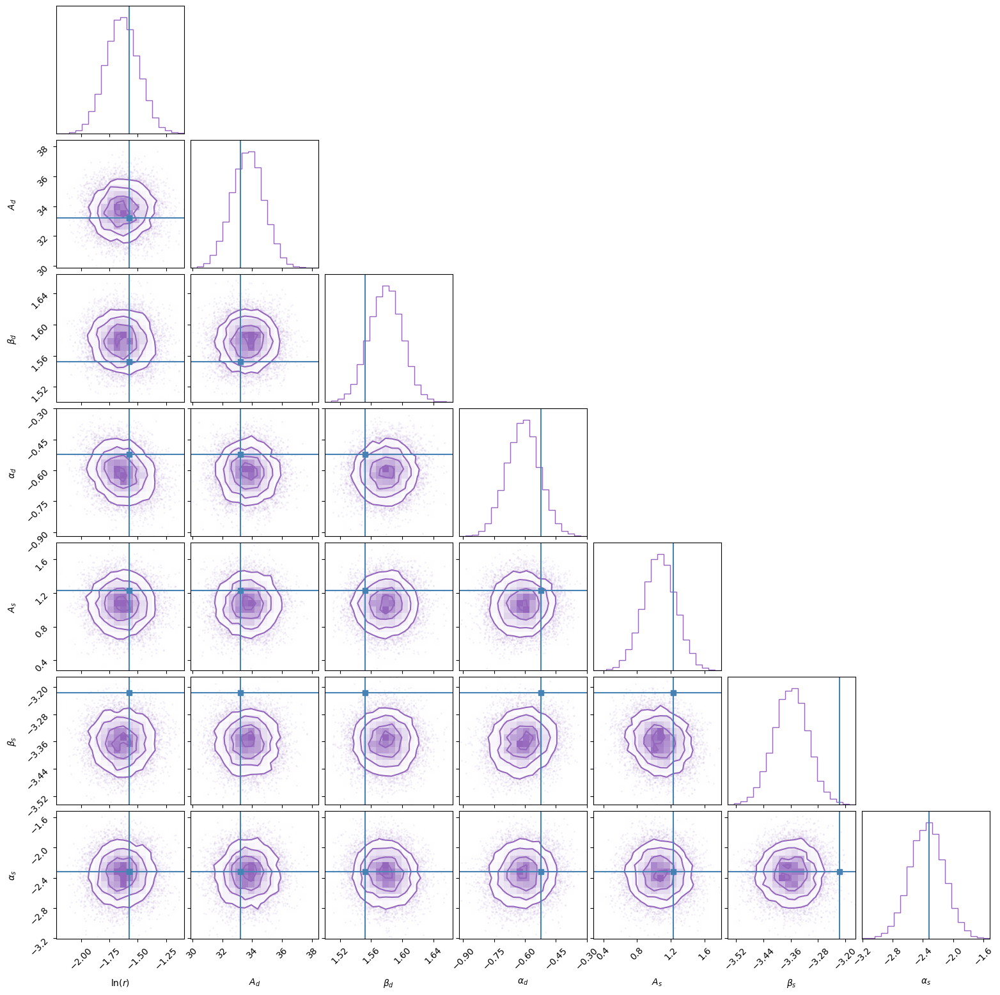

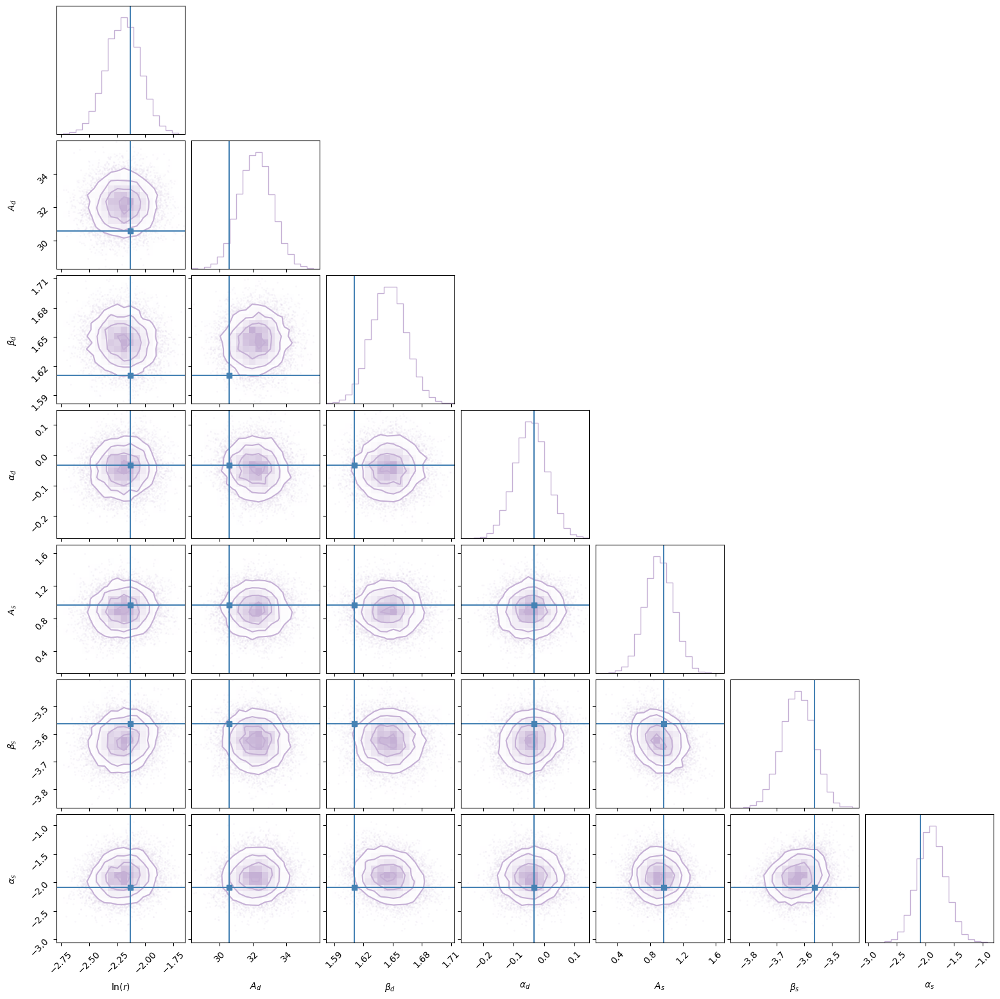

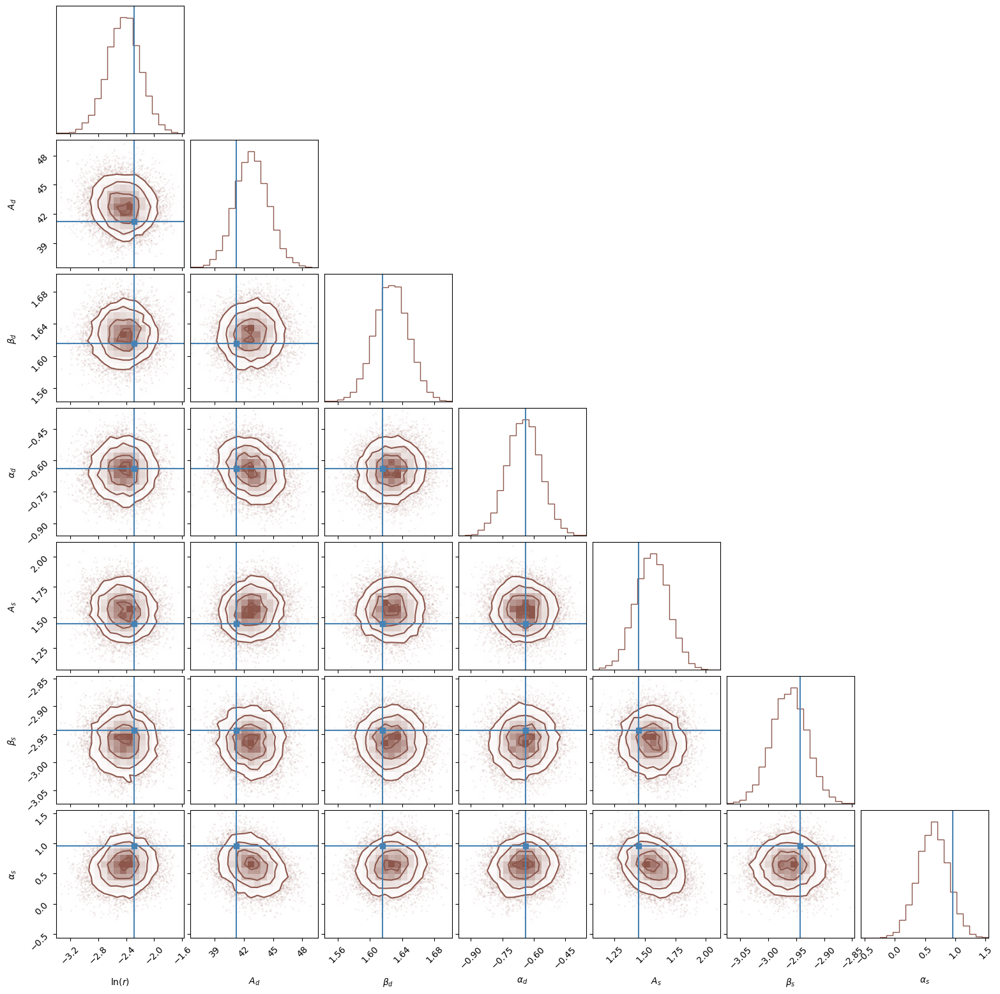

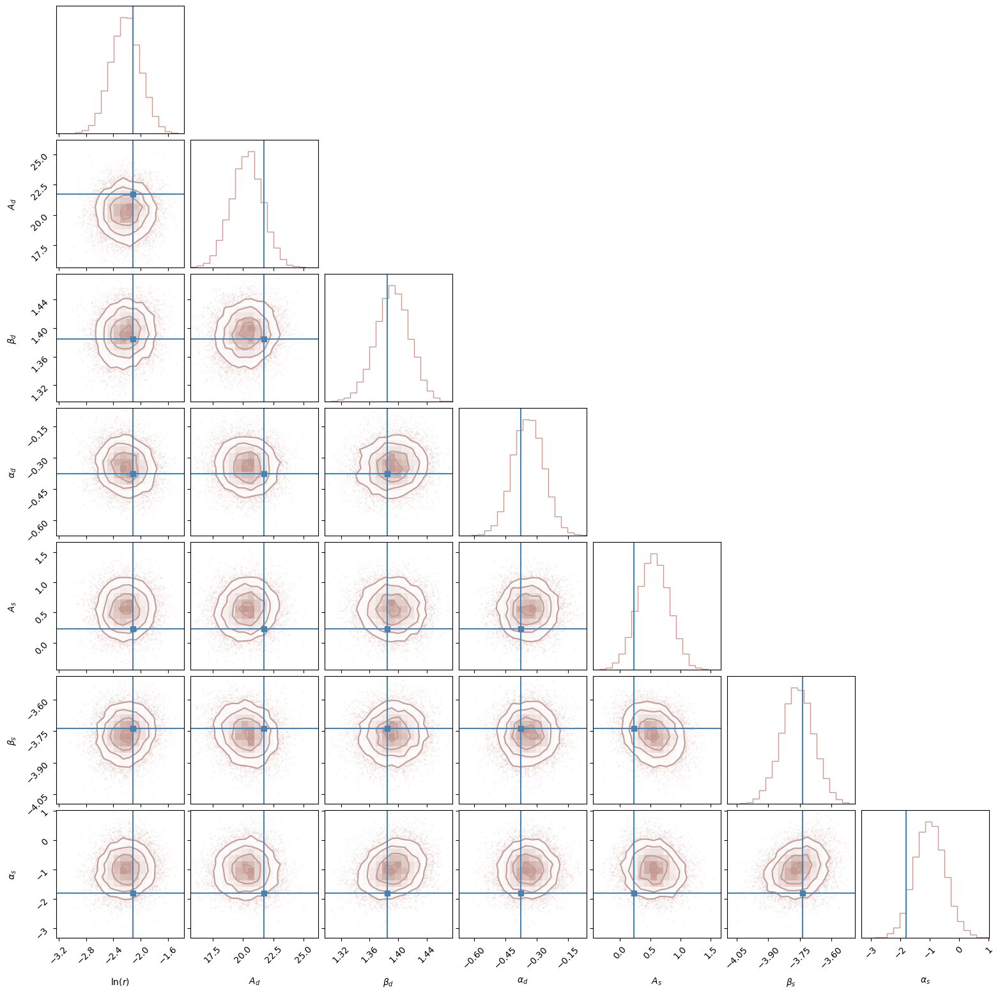

In [100]:
cmap2 = matplotlib.cm.get_cmap("tab20")
for i in range(12):
    lilith_posteriors = posterior_lilith.sample((10000,), x=binned_data_tensor[ntrain+i])
    corner.corner(np.array(lilith_posteriors), labels=[r"$\ln(r)$", r"$A_d$", r"$\beta_d$",r"$\alpha_d$", 
                                              r"$A_s$", r"$\beta_s$",r"$\alpha_s$"], 
              figsize=(6,6), dpi=100, color=cmap2(i/20.), truths=np.array(params_tensor[ntrain+i]))

In [101]:
lilith_posteriors = np.empty((ntest, 10000, 7))
eve_posteriors = np.empty((ntest, 10000, 7))
for i in range(ntest):
    lilith_posteriors[i] = posterior_lilith.sample((10000,), x=binned_data_tensor[ntrain+i])
    eve_posteriors[i] = posterior_eve.sample((10000,), x=binned_data_tensor[ntrain+i])
stats_lilith = np.percentile(lilith_posteriors, [31.7, 50, 68.3], axis=1)
stats_eve = np.percentile(eve_posteriors, [31.7, 50, 68.3], axis=1)

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:27<00:00, 370.26it/s]


Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 370.51it/s]


In [103]:
np.save("test_posteriors_foregrounds_0_00025.npy", lilith_posteriors)
np.save("test_posteriors_foregrounds_0_00100.npy", eve_posteriors)
np.save("test_posteriors_foregrounds_0_00050.npy", test_posteriors)

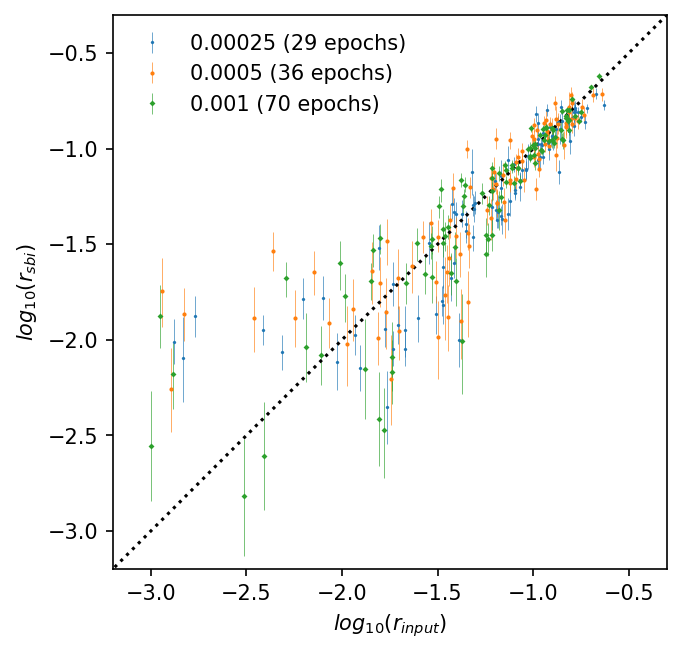

In [113]:
fig1, ax1 = plt.subplots(dpi=150)

ym_r = np.log10(np.exp(stats_lilith[1,:,0]))-np.log10(np.exp(stats_lilith[0,:,0]))
yp_r =  np.log10(np.exp(stats_lilith[2,:,0]))-np.log10(np.exp(stats_lilith[1,:,0]))
ax1.errorbar(np.log10(np.exp(params_tensor[ntrain:,0]))*0.98, np.log10(np.exp(stats_lilith[1,:,0])), yerr=[ym_r, yp_r], 
             ls="", marker="x", color="tab:blue", linewidth=0.3, markersize=1, label="0.00025 (29 epochs)")

ym_r = np.log10(np.exp(stats_test[1,:,0]))-np.log10(np.exp(stats_test[0,:,0]))
yp_r =  np.log10(np.exp(stats_test[2,:,0]))-np.log10(np.exp(stats_test[1,:,0]))
ax1.errorbar(np.log10(np.exp(params_tensor[ntrain:,0])), np.log10(np.exp(stats_test[1,:,0])), yerr=[ym_r, yp_r], 
             ls="", marker="o", color="tab:orange", linewidth=0.3, markersize=1, label="0.0005 (36 epochs)")

ym_r = np.log10(np.exp(stats_eve[1,:,0]))-np.log10(np.exp(stats_eve[0,:,0]))
yp_r =  np.log10(np.exp(stats_eve[2,:,0]))-np.log10(np.exp(stats_eve[1,:,0]))
ax1.errorbar(np.log10(np.exp(params_tensor[ntrain:,0]))*1.02, np.log10(np.exp(stats_eve[1,:,0])), yerr=[ym_r, yp_r], 
             ls="", marker="D", color="tab:green", linewidth=0.3, markersize=1, label="0.001 (70 epochs)")



ax1.plot([-4, 0], [-4, 0], "k:")
ax1.set_xlabel(r"$log_{10}(r_{input})$")
#ax1.set_xscale("log")
ax1.set_xlim(-3.2,-0.3)
ax1.set_ylim(-3.2,-0.3)
ax1.set_ylabel(r"$log_{10}(r_{sbi})$")
#ax1.set_yscale("log")
ax1.set_aspect('equal')
ax1.legend(frameon=False)

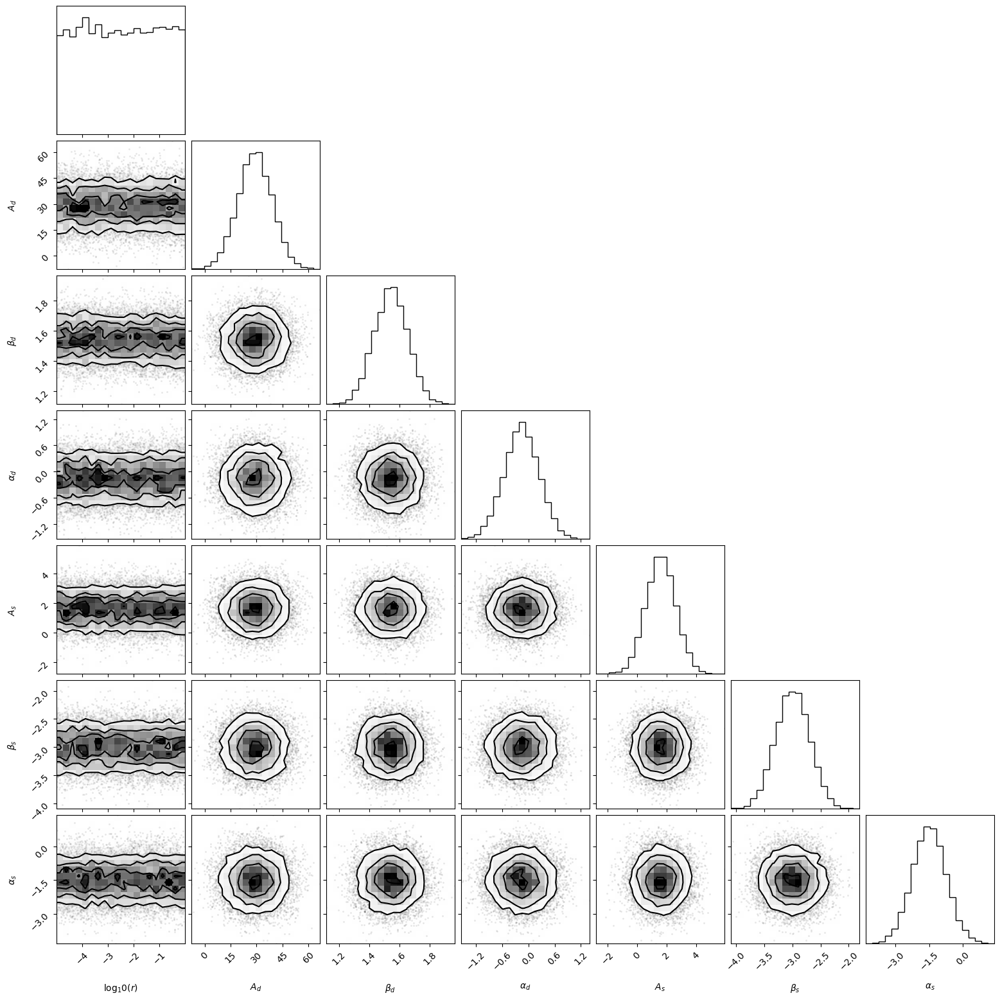

In [11]:
#Other parameters: uniform prior on log10(r) between -5 and 0, tighter prior on alpha_s
data_tensor_newdist = np.load("data_tensor_newdist.npy")

log10_r_vector_newdist = np.log10(np.load("r_vector_newdist.npy"))

Ad_vector_newdist = np.load("Ad_vector_newdist.npy")
Bd_vector_newdist = np.load("betad_vector_newdist.npy")
alphad_vector_newdist = np.load("alphad_vector_newdist.npy")

As_vector_newdist = np.load("As_vector_newdist.npy")
Bs_vector_newdist = np.load("betas_vector_newdist.npy")
alphas_vector_newdist = np.load("alphas_vector_newdist.npy")
parameter_tensor_newdist = np.stack((log10_r_vector_newdist, 
                                  Ad_vector_newdist, 
                                  Bd_vector_newdist, 
                                  alphad_vector_newdist, 
                                  As_vector_newdist, 
                                  Bs_vector_newdist, 
                                  alphas_vector_newdist))
params_tensor_newdist = parameter_tensor_newdist.T
figure = corner.corner(params_tensor_newdist, labels=[r"$\log_10(r)$", r"$A_d$", r"$\beta_d$",r"$\alpha_d$", 
                                              r"$A_s$", r"$\beta_s$",r"$\alpha_s$"], figsize=(6,6), dpi=100)
plt.show()

In [12]:
#Bin and train on the new parameters
data_tensor_newdist = data_tensor_newdist*np.broadcast_to(idfac, (nsims, nCl))
binned_data_tensor_newdist = np.empty((nsims, nbins-nspec))
t1 = time()
for i in range(nsims):
    binned_data_tensor_newdist[i] = bin_spectrum(data_tensor_newdist[i], big_bin=False)
print(f"Binned {nsims} samples (binwidth {binwidth}) in {time()-t1:.3f}s")

t1 = time()
posterior_newdist = sbi_posterior(None, params_tensor_newdist[:ntrain], binned_data_tensor_newdist[:ntrain], 
                                  density_estimator="maf")
print(f" Trained in {time()-t1:.2f}s with density estimator maf and learning rate 0.0005")

Binned 10000 samples (binwidth 10) in 83.191s
 Neural network successfully converged after 37 epochs.
        -------------------------
        ||||| ROUND 1 STATS |||||:
        -------------------------
        Epochs trained: 37
        Best validation performance: 2.1837
        -------------------------
        
 Trained in 495.84s with density estimator maf and learning rate 0.0005



Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.17it/s]

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.20it/s]

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.00it/s]

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 370.93it/s]

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.38it/s]

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.40it/s]

Drawing 10000 posterior samples: 100%|███████████████████

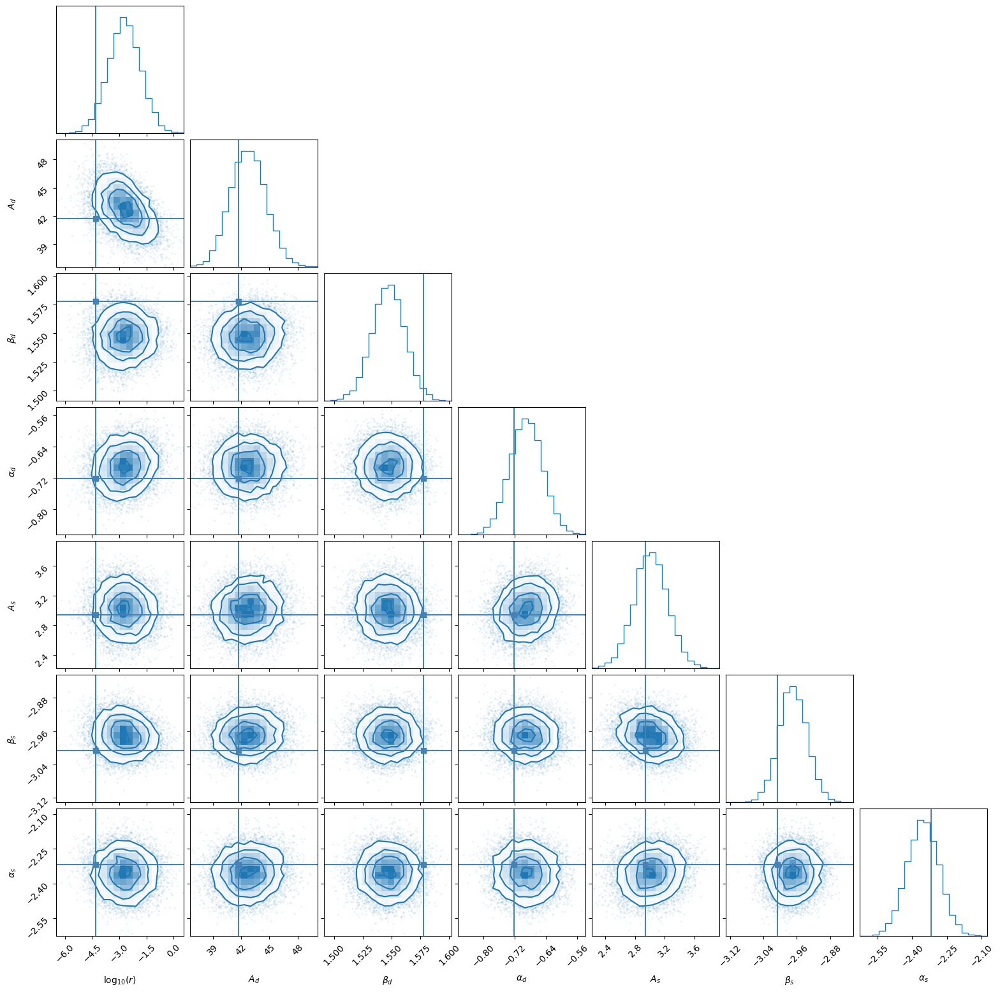

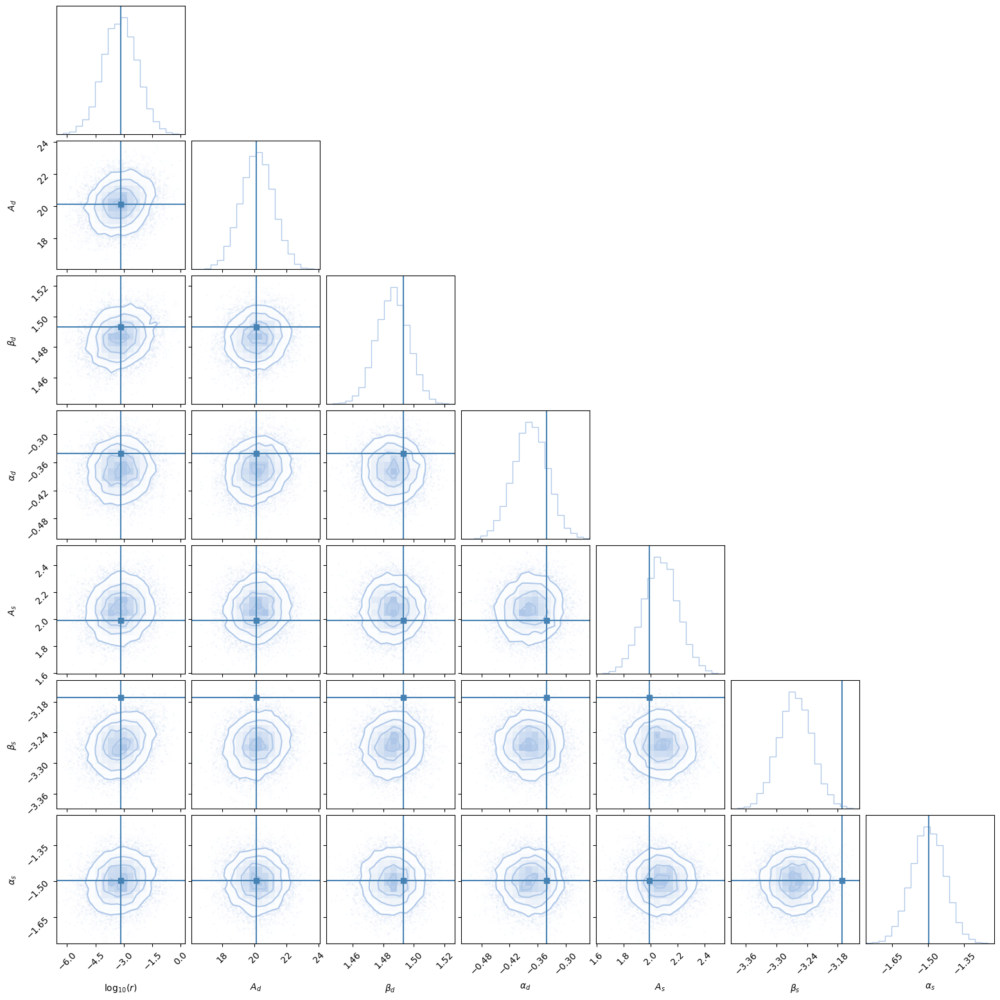

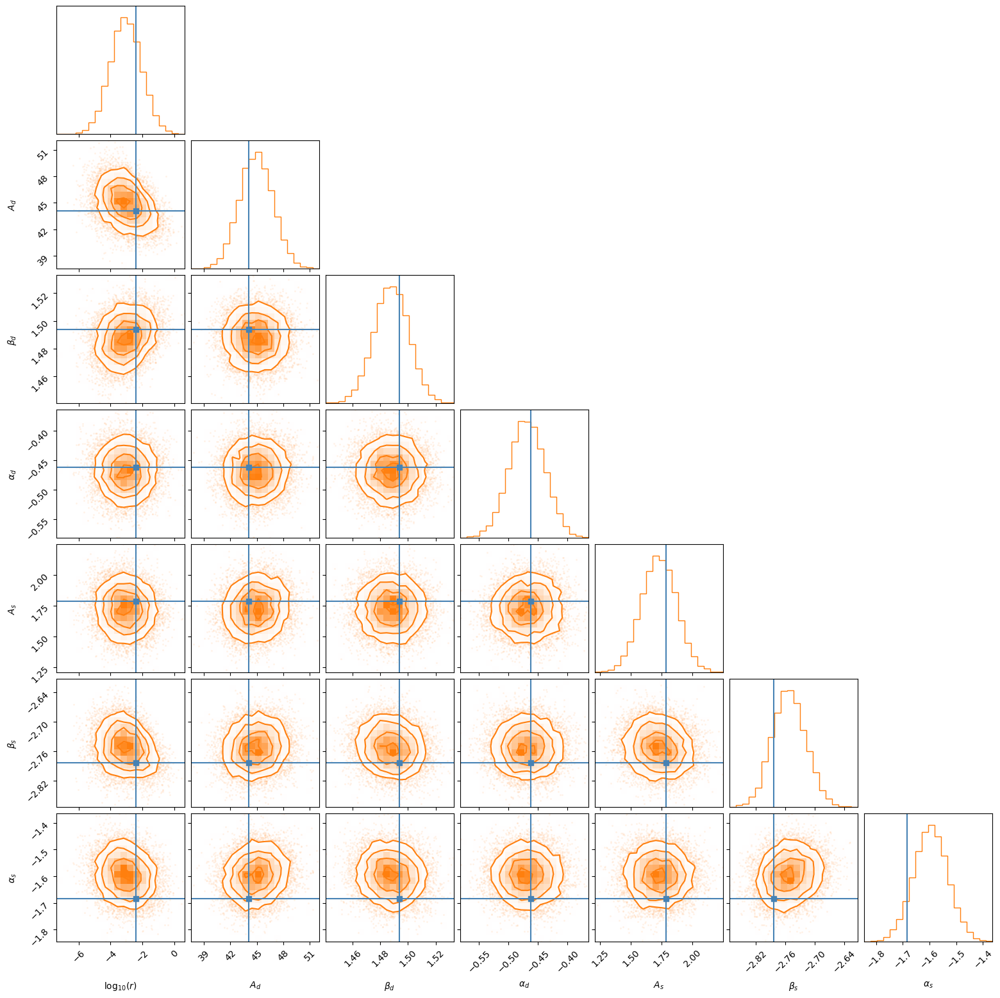

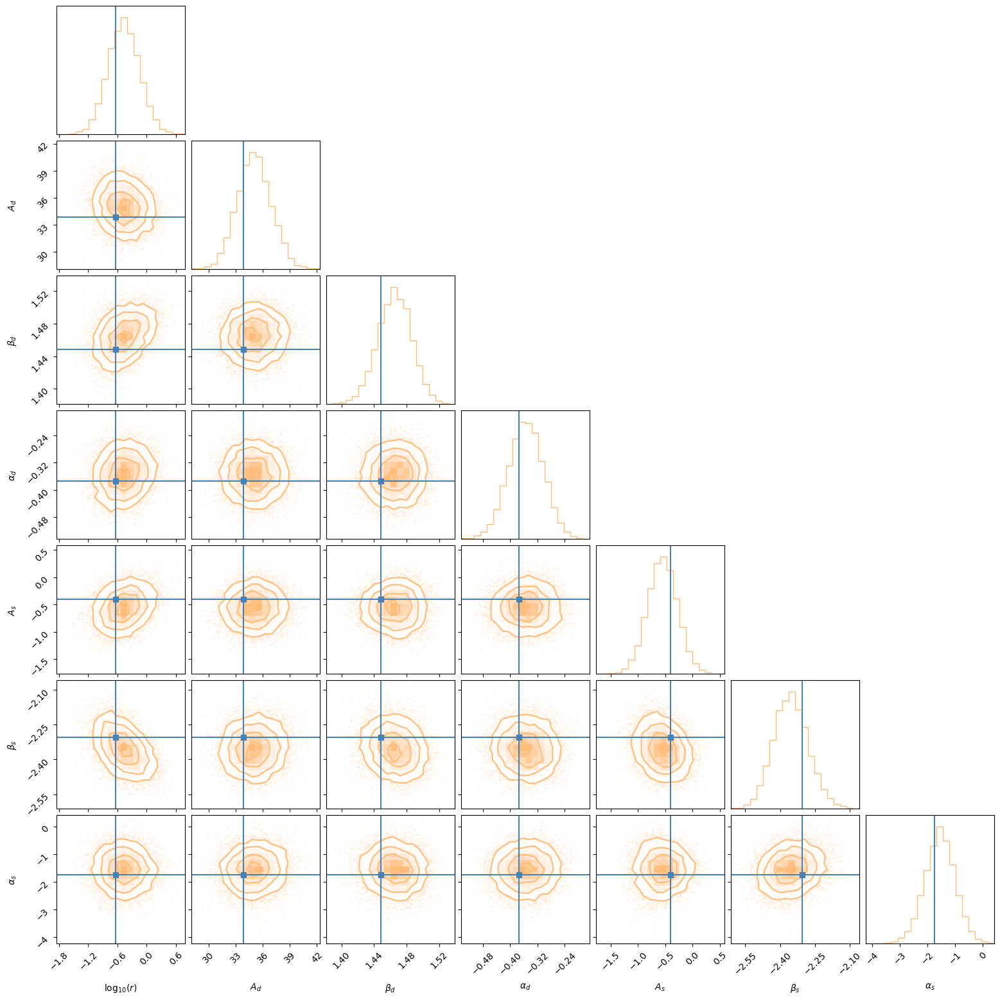

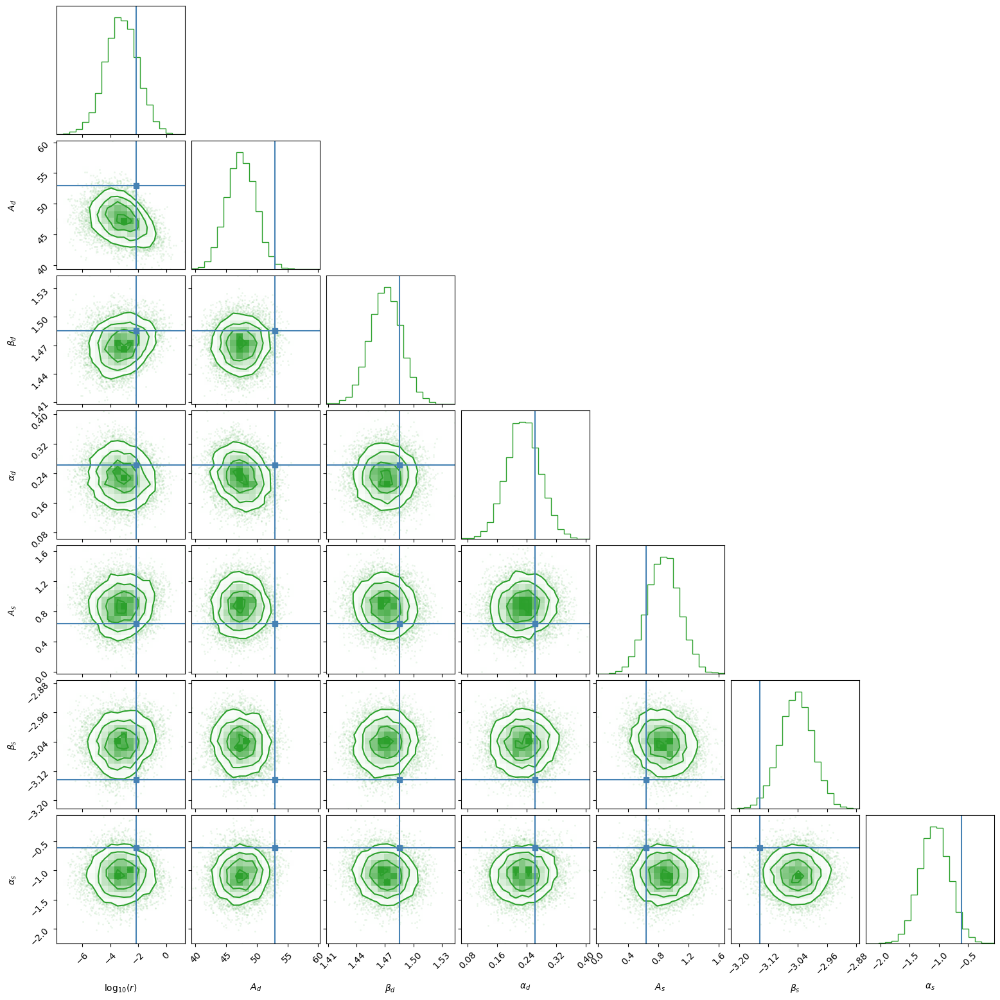

...

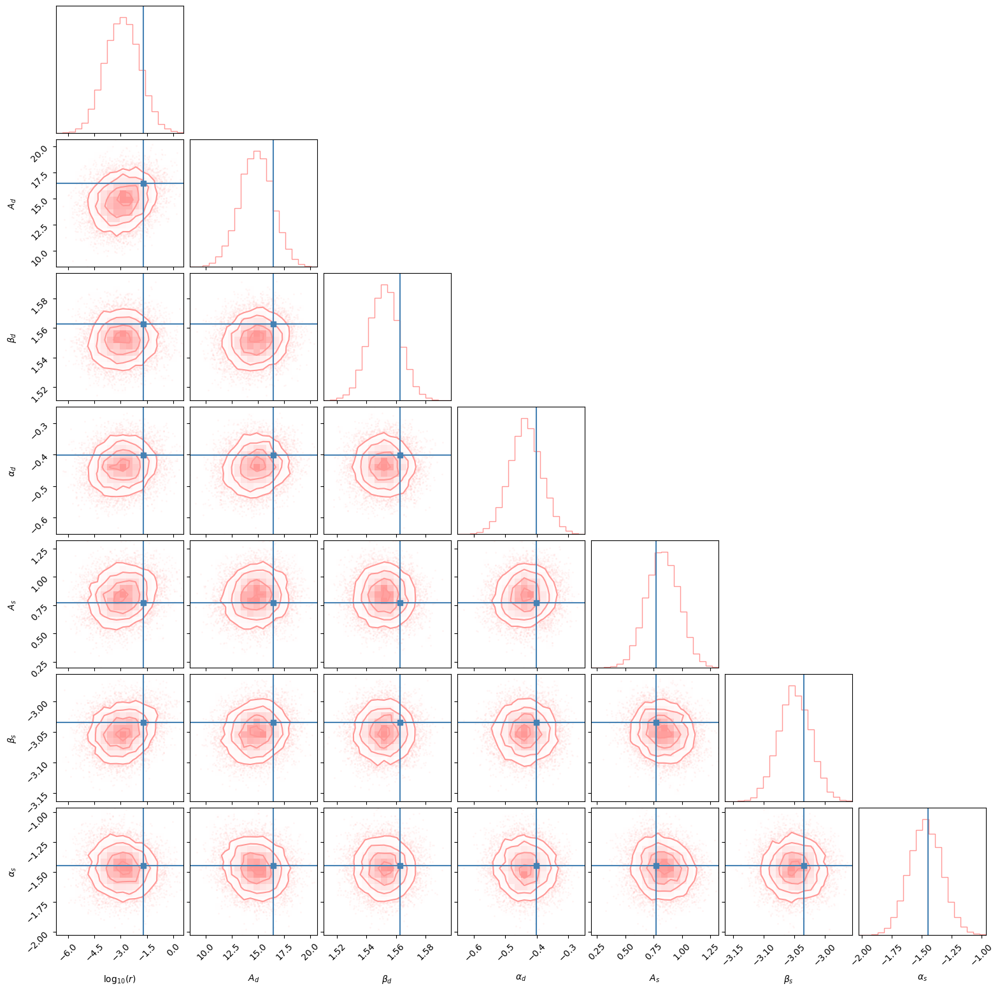

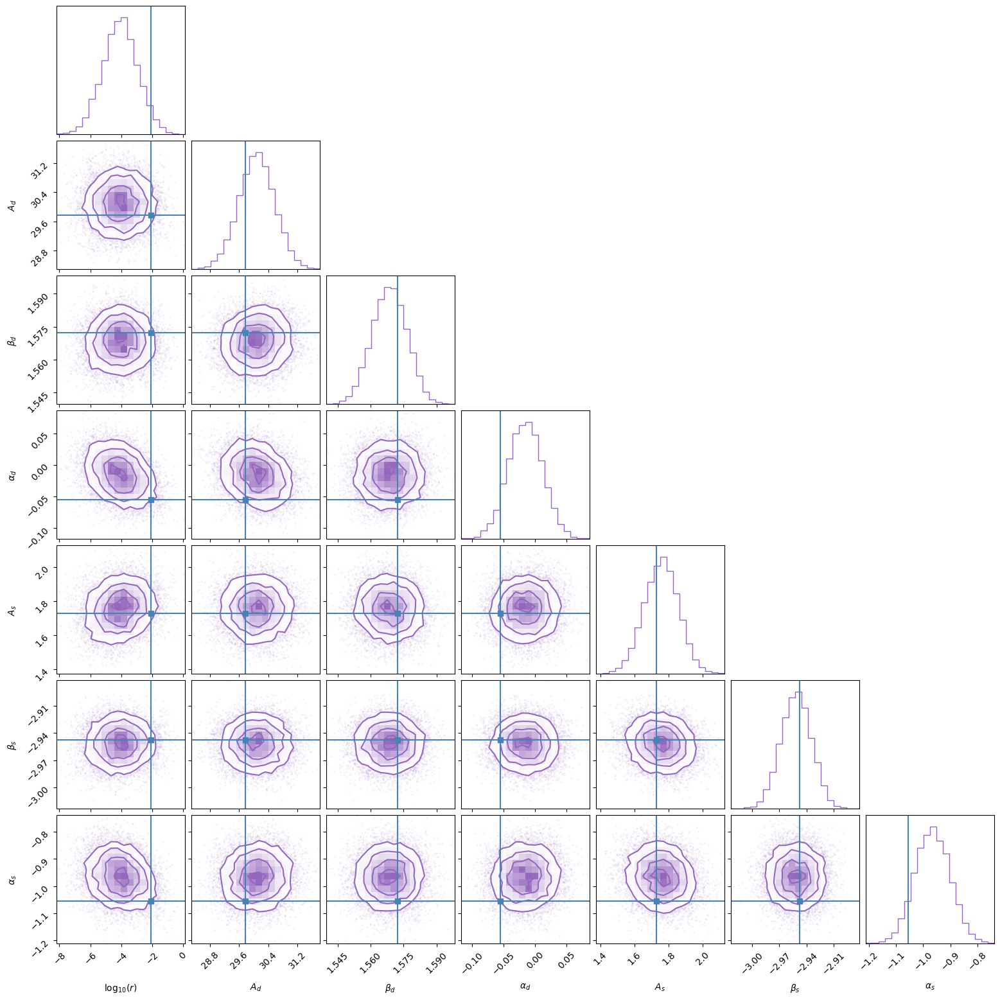

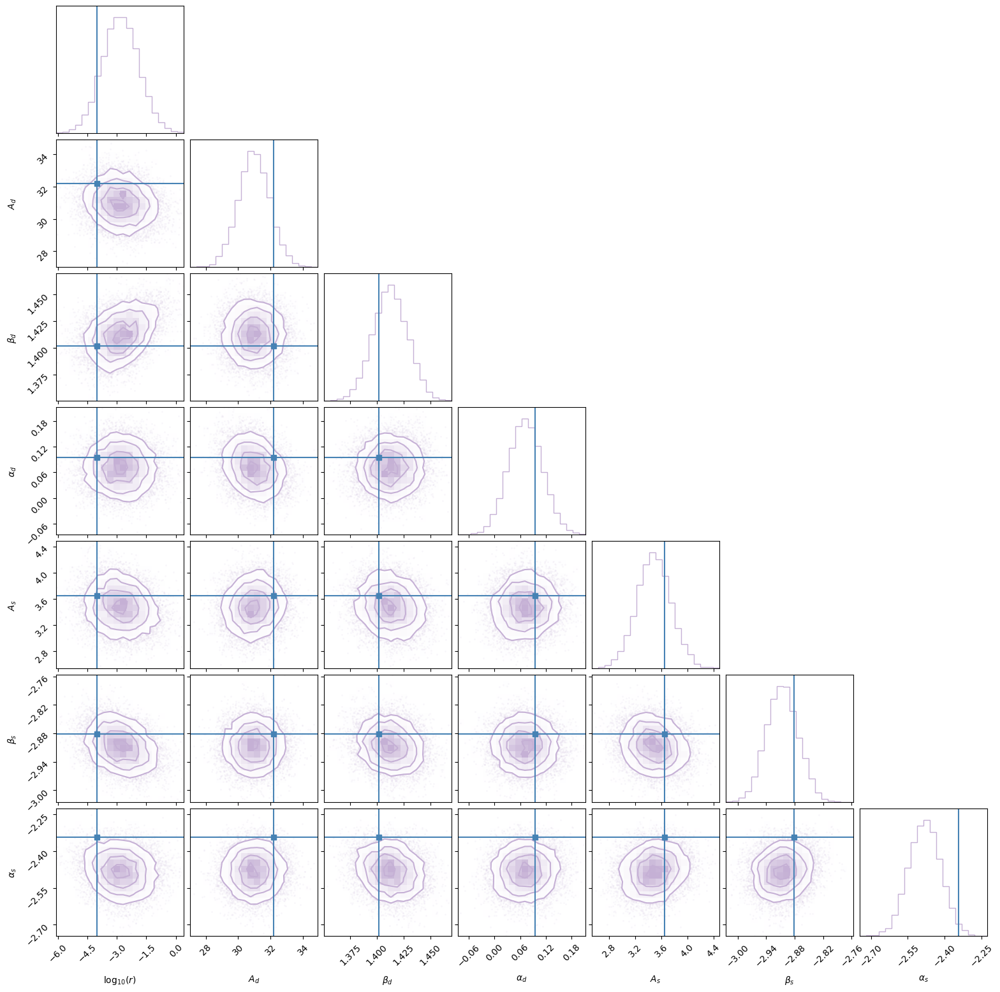

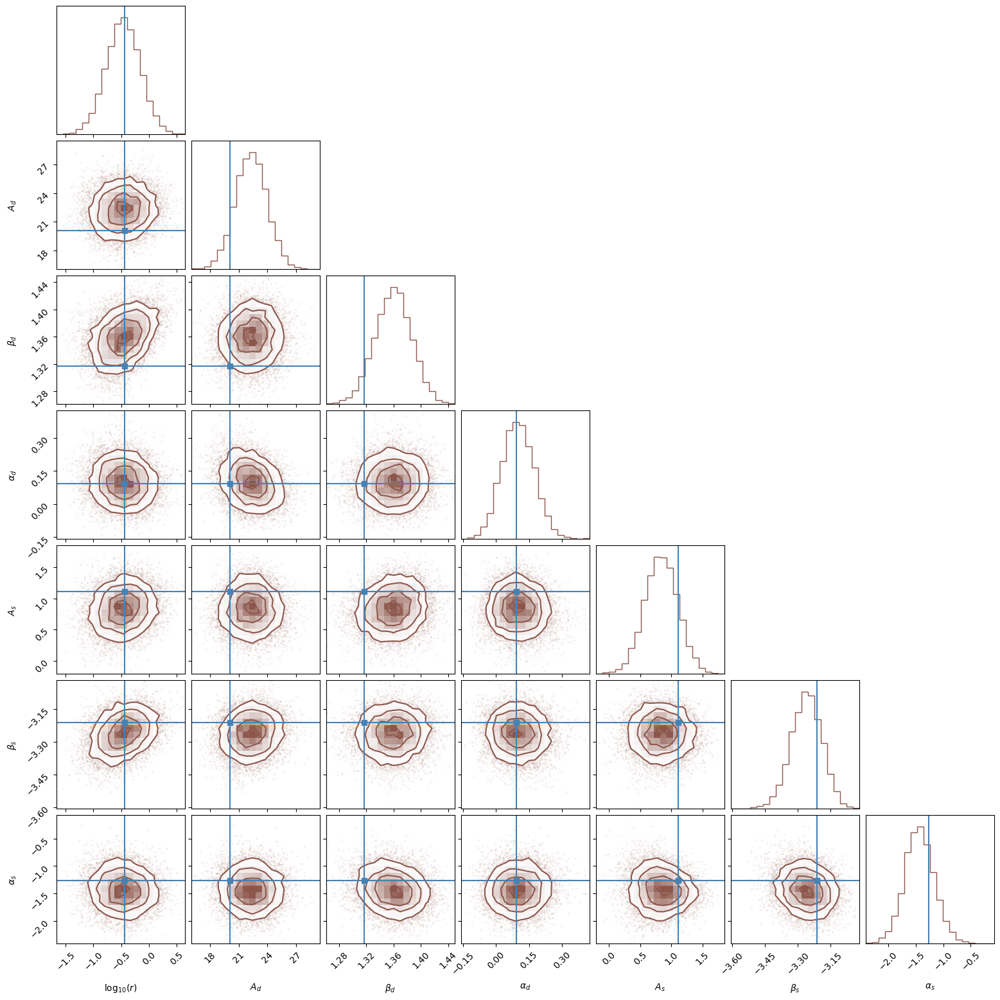

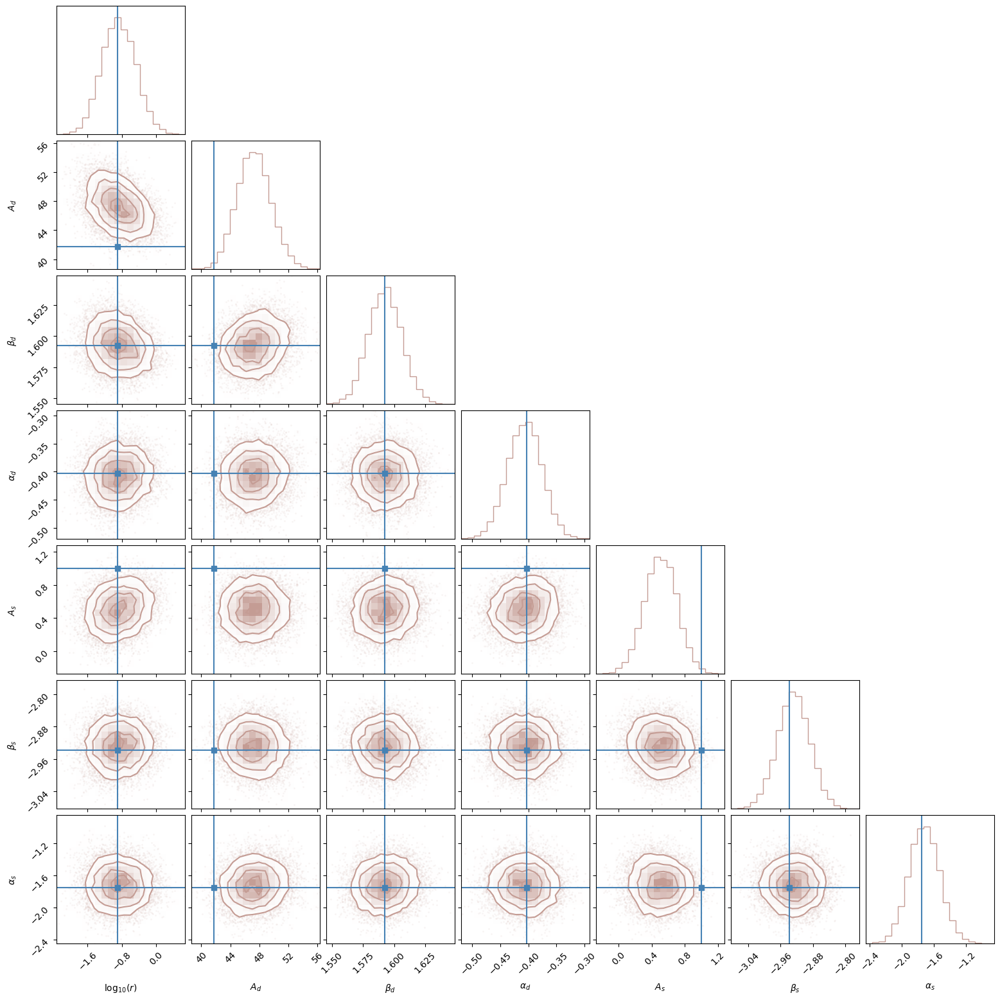

In [14]:
#Plot some posteriors
for i in range(12):
    pos_sam_newdist = posterior_newdist.sample((10000,), x=binned_data_tensor_newdist[ntrain+i])
    corner.corner(np.array(pos_sam_newdist), labels=[r"$\log_{10}(r)$", r"$A_d$", r"$\beta_d$",r"$\alpha_d$", 
                                              r"$A_s$", r"$\beta_s$",r"$\alpha_s$"], 
              figsize=(6,6), dpi=100, color=cmap2(i/20.), truths=np.array(params_tensor_newdist[ntrain+i]))

In [15]:
#Compare r coverage with normal model
test_posteriors_olddist = np.load("test_posteriors_foregrounds_0_00050.npy")
test_posteriors_newdist = np.empty((ntest, 10000, 7))
for i in range(ntest):
    test_posteriors_newdist[i] = posterior_newdist.sample((10000,), x=binned_data_tensor_newdist[ntrain+i])


Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.17it/s]

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.32it/s]

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.40it/s]

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.38it/s]

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.33it/s]

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.35it/s]

Drawing 10000 posterior samples: 100%|███████████████████

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.31it/s]

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.35it/s]

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.32it/s]

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 370.86it/s]

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.22it/s]

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.10it/s]

Drawing 10000 posterior samples: 100%|████████████████████

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.28it/s]

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.23it/s]

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 370.95it/s]

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.03it/s]

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.34it/s]

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.45it/s]

Drawing 10000 posterior samples: 100%|████████████████████

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.16it/s]

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.20it/s]

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.36it/s]

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.43it/s]

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.40it/s]

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 371.34it/s]

Drawing 10000 posterior samples: 100%|████████████████████

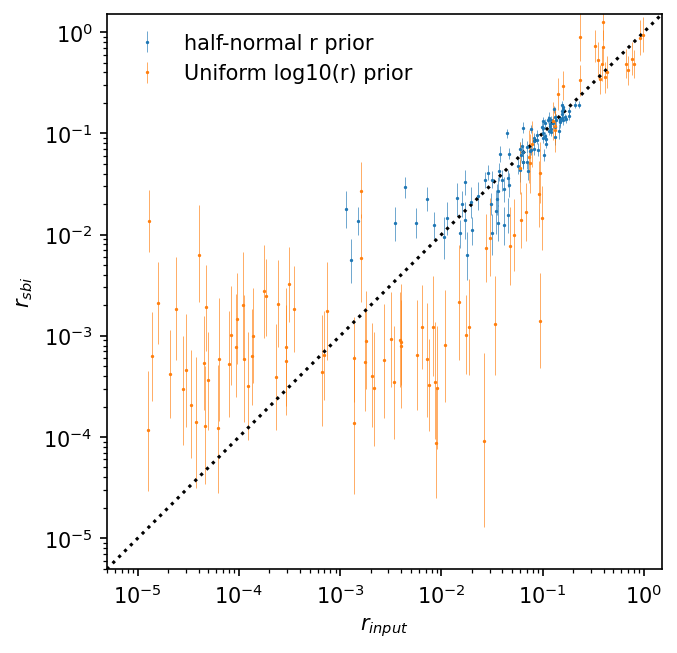

In [26]:
fig1, ax1 = plt.subplots(dpi=150)

stats_test_old = np.percentile(test_posteriors_olddist, [31.7, 50, 68.3], axis=1)
ym_r = np.exp(stats_test_old[1,:,0])-np.exp(stats_test_old[0,:,0])
yp_r =  np.exp(stats_test_old[2,:,0])-np.exp(stats_test_old[1,:,0])
ax1.errorbar(np.exp(params_tensor[ntrain:,0]), np.exp(stats_test_old[1,:,0]), yerr=[ym_r, yp_r], 
             ls="", marker="o", color="tab:blue", linewidth=0.3, markersize=0.6, label="half-normal r prior")

stats_test_new = np.percentile(test_posteriors_newdist, [31.7, 50, 68.3], axis=1)
ym_r = 10.**stats_test_new[1,:,0]-10.**stats_test_new[0,:,0]
yp_r =  10.**stats_test_new[2,:,0]-10.**stats_test_new[1,:,0]
ax1.errorbar(10.**log10_r_vector_newdist[ntrain:], 10.**stats_test_new[1,:,0], yerr=[ym_r, yp_r], 
             ls="", marker="o", color="tab:orange", linewidth=0.3, markersize=0.6, label="Uniform log10(r) prior")

ax1.plot([1e-6, 2], [1e-6, 2], "k:")
ax1.set_xlabel(r"$r_{input}$")
ax1.set_xscale("log")
ax1.set_xlim(5e-6, 1.5)
ax1.set_ylim(5e-6, 1.5)
ax1.set_ylabel(r"$r_{sbi}$")
ax1.set_yscale("log")
ax1.set_aspect('equal')
ax1.legend(frameon=False)

Text(0, 0.5, '$\\alpha_s^{sbi}$')

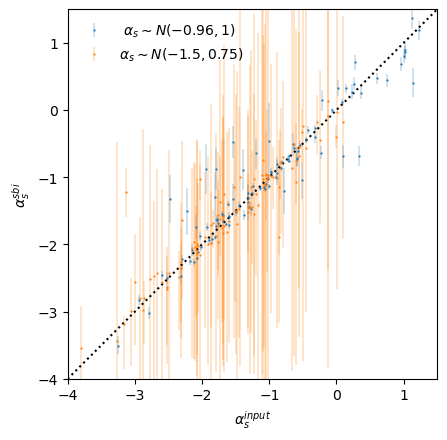

In [40]:
fig2, ax2 = plt.subplots()
ax2.set_aspect('equal')
ym_as = stats_test_old[1,:,6]-stats_test_old[0,:,6]
yp_as =  stats_test_old[2,:,6]-stats_test_old[1,:,6]
ax2.errorbar(params_tensor[ntrain:,6], stats_test_old[1,:,6], yerr=[ym_as, yp_as], 
             ls="", marker="o", color="tab:blue", linewidth=0.3, markersize=0.6, label=r" $\alpha_s\sim N(-0.96, 1)$")

ym_as = stats_test_new[1,:,6]-stats_test_new[0,:,0]
yp_as =  stats_test_new[2,:,6]-stats_test_new[1,:,0]
ax2.errorbar(alphas_vector_newdist[ntrain:], stats_test_new[1,:,6], yerr=[ym_as, yp_as], 
             ls="", marker="o", color="tab:orange", linewidth=0.3, markersize=0.6, label=r"$\alpha_s\sim N(-1.5, 0.75)$")
ax2.plot([-4, 2], [-4, 2], "k:")
ax2.set_xlim(-4, 1.5)
ax2.set_ylim(-4, 1.5)
ax2.legend(frameon=False)
ax2.set_xlabel(r"$\alpha_s^{input}$")
ax2.set_ylabel(r"$\alpha_s^{sbi}$")


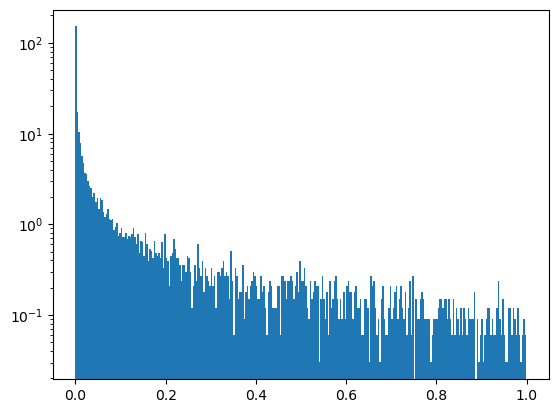

In [29]:
plt.hist(10.**log10_r_vector_newdist, bins=300, density=True)
plt.yscale("log")
plt.show()

In [41]:
t1 = time()
posterior_cain = sbi_posterior(None, params_tensor[:ntrain], binned_data_tensor[:ntrain], 
                              density_estimator="maf", learning_rate=0.01)
print(f" Trained in {time()-t1:.2f}s with learning rate 0.01")

 Neural network successfully converged after 100 epochs.
        -------------------------
        ||||| ROUND 1 STATS |||||:
        -------------------------
        Epochs trained: 100
        Best validation performance: 0.9360
        -------------------------
        
 Trained in 1309.99s with learning rate 0.01


In [42]:
cain_posteriors = np.empty((ntest, 10000, 7))
for i in range(ntest):
    cain_posteriors[i] = posterior_cain.sample((10000,), x=binned_data_tensor[ntrain+i])

Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 372.10it/s]


Drawing 10000 posterior samples: 100%|██████████████████████████████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 372.13it/s]


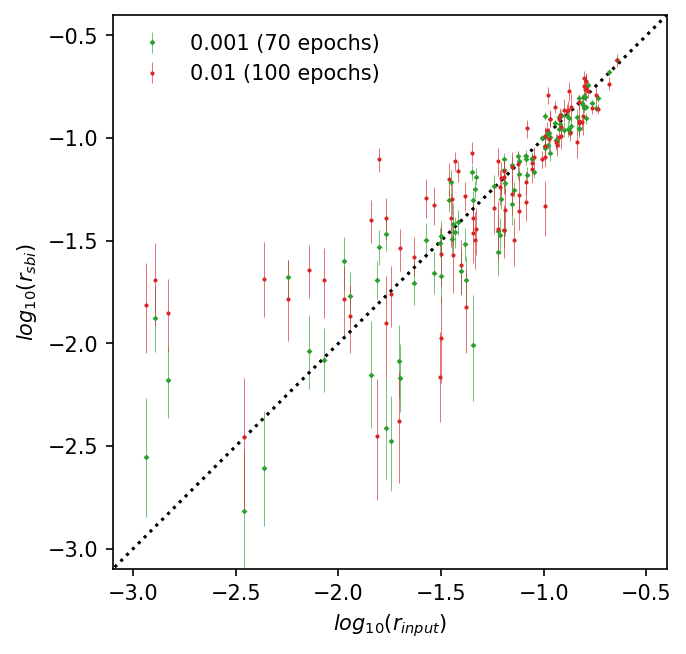

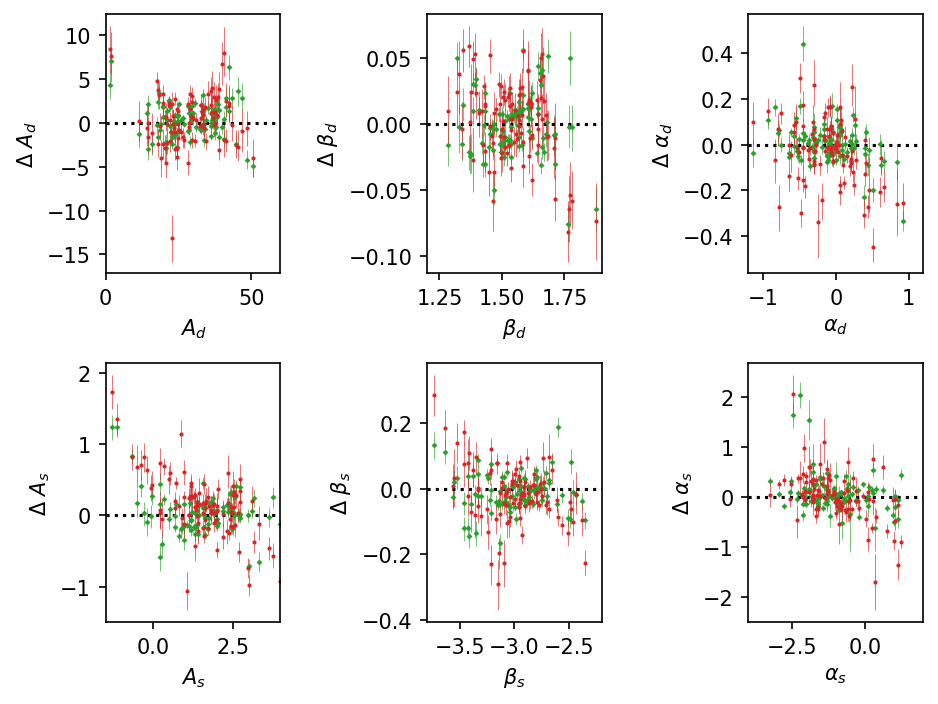

In [58]:
np.save("test_posteriors_foregrounds_0_01000.npy", cain_posteriors)

eve_posteriors = np.load("test_posteriors_foregrounds_0_00100.npy")
stats_cain = np.percentile(cain_posteriors, [31.7, 50, 68.3], axis=1)
stats_eve = np.percentile(eve_posteriors, [31.7, 50, 68.3], axis=1)
fig1, ax1 = plt.subplots(dpi=150)

ym_r = np.log10(np.exp(stats_eve[1,:,0]))-np.log10(np.exp(stats_eve[0,:,0]))
yp_r =  np.log10(np.exp(stats_eve[2,:,0]))-np.log10(np.exp(stats_eve[1,:,0]))
ax1.errorbar(np.log10(np.exp(params_tensor[ntrain:,0])), np.log10(np.exp(stats_eve[1,:,0])), yerr=[ym_r, yp_r], 
             ls="", marker="D", color="tab:green", linewidth=0.3, markersize=1, label="0.001 (70 epochs)")

ym_r = np.log10(np.exp(stats_cain[1,:,0]))-np.log10(np.exp(stats_cain[0,:,0]))
yp_r =  np.log10(np.exp(stats_cain[2,:,0]))-np.log10(np.exp(stats_cain[1,:,0]))
ax1.errorbar(np.log10(np.exp(params_tensor[ntrain:,0])), np.log10(np.exp(stats_cain[1,:,0])), yerr=[ym_r, yp_r], 
             ls="", marker="o", color="tab:red", linewidth=0.3, markersize=1, label="0.01 (100 epochs)")

ax1.plot([-4, 0], [-4, 0], "k:")
ax1.set_xlabel(r"$log_{10}(r_{input})$")
#ax1.set_xscale("log")
ax1.set_xlim(-3.1,-0.4)
ax1.set_ylim(-3.1,-0.4)
ax1.set_ylabel(r"$log_{10}(r_{sbi})$")
#ax1.set_yscale("log")
ax1.set_aspect('equal')
ax1.legend(frameon=False)

param_names = [r"$A_d$", r"$\beta_d$",r"$\alpha_d$", r"$A_s$", r"$\beta_s$",r"$\alpha_s$"]
param_edges = [(0,60), (1.2, 1.9), (-1.2, 1.2), (-1.5, 4), (-3.8, -2.2), (-4,2)]
fig2, ax2 = plt.subplots(2,3, dpi=150)
for i, ax in enumerate(ax2.flat):
    y_i = stats_eve[1,:,1+i]
    ym_i = stats_eve[1,:,1+i]-stats_eve[0,:,1+i]
    yp_i = stats_eve[2,:,1+i]-stats_eve[1,:,1+i]
    ax.errorbar(params_tensor[ntrain:,1+i], y_i-params_tensor[ntrain:,1+i], yerr=[ym_i, yp_i], ls="", marker="D", 
                color="tab:green", linewidth=0.3, markersize=1, label="0.001 (70 epochs)" )
    y_ii = stats_cain[1,:,1+i]
    ym_ii = stats_cain[1,:,1+i]-stats_cain[0,:,1+i]
    yp_ii = stats_cain[2,:,1+i]-stats_cain[1,:,1+i]
    ax.errorbar(params_tensor[ntrain:,1+i], y_ii-params_tensor[ntrain:,1+i], yerr=[ym_ii, yp_ii], ls="", marker="o", 
                color="tab:red", linewidth=0.3, markersize=1, label="0.01 (100 epochs)" )
    #ax.set_aspect('equal')
    ax.plot(param_edges[i], [0,0], "k:")
    ax.set_xlim(param_edges[i])
    #ax.set_ylim(param_edges[i])
    ax.set_ylabel(fr"$\Delta$ {param_names[i]}")
    ax.set_xlabel(param_names[i])
plt.tight_layout()

In [103]:
log_file = open("sbi-logs/SNPE_C/2024-02-09T18_47_40.011872/events.out.tfevents.1707500860.owl31.uio.no.3243609.2", 
                "rb")
for line in log_file.readlines():
    print(line.decode("latin1"))

brain.Event:2ê$       B+M	~zqÙA*



epochs_trained  ÈBµl.       ÅËWú	ázqÙA*!



best_validation_log_prob] o?«J(       ÿpJ	ªzqÙA*



validation_log_probs3wÀÂ_*       ®õ	dzqÙA*



validation_log_probs¢4º¿+}jD*       ®õ	0zqÙA*



validation_log_probs6;³¿IÚÄN*       ®õ	ÆzqÙA*



validation_log_probsLrh¿z`¦*       ®õ	UzqÙA*



validation_log_probs\æ¾<´$*       ®õ	ázqÙA*



validation_log_probsúÏ¾\c¥*       ®õ	jzqÙA*



validation_log_probs>m¿nê7¢*       ®õ	ñzqÙA*



validation_log_probsá.«¾õL¸*       ®õ	yzqÙA*



validation_log_probs¥¾*       ®õ	 zqÙA	*



validation_log_probsè­Ú¼&ËÎ]*       ®õ	Õ{qÙA

*



validation_log_probsY©½¤G/0*       ®õ	ß{qÙA*



validation_log_probs©Ül<ôu,#*       ®õ	Â{qÙA*



*



validation_log_probsÆc'=yï+*       ®õ	w{qÙA*



{qÙA*



validation_log_probsÞÿp¼¿"by*   

['epochs_trained', 'best_validation_log_prob', 'validation_log_probs', 'training_log_probs', 'epoch_durations_sec']
['epochs_trained', 'best_validation_log_prob', 'validation_log_probs', 'training_log_probs', 'epoch_durations_sec']
([1], [0.9360406994819641])


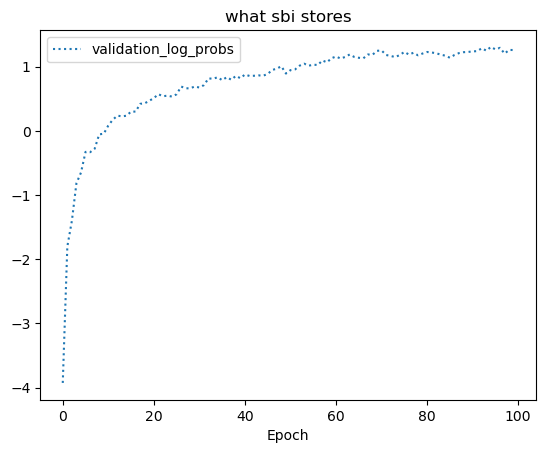

In [115]:
from tensorboard.backend.event_processing.event_accumulator import EventAccumulator

def read_tensorboard_log(logdir, tag='validation_loss'):
    event_acc = EventAccumulator(logdir)
    event_acc.Reload()

    # Get all available tags in the log file
    tags = event_acc.Tags()['scalars']
    print(tags)
    if tag not in tags:
        raise ValueError(f'Tag "{tag}" not found in the TensorBoard log.')

    # Get the values for the specified tag
    events = event_acc.Scalars(tag)

    # Extract step and value for each event
    steps = [event.step for event in events]
    values = [event.value for event in events]

    return steps, values

def plot_validation_loss(logdir):
    steps, var = read_tensorboard_log(logdir, tag='training_log_probs')
    print(read_tensorboard_log(logdir, tag='best_validation_log_prob'))
    #plt.plot(steps, var, label='training_log_probs')
    plt.plot(steps, var, label='validation_log_probs', ls=":")
    plt.xlabel('Epoch')
    plt.ylabel('')
    plt.title('what sbi stores')
    plt.legend()
    plt.show()

# Replace 'your_log_directory' with the path to your TensorBoard log directory
log_directory = "sbi-logs/SNPE_C/2024-02-09T18_47_40.011872/events.out.tfevents.1707500860.owl31.uio.no.3243609.2"

plot_validation_loss(log_directory)


In [105]:
from sbi.analysis import plot_summary
plot_summary(posterior_cain)

ValueError: inference Posterior conditional density p(θ|x) of type DirectPosterior. It samples the posterior network and rejects samples that
            lie outside of the prior bounds.